# Self-Driving Car Engineer Nanodegree 
## Project IV : Advanced Lane Lines


[![Udacity - Self-Driving Car NanoDegree](https://s3.amazonaws.com/udacity-sdc/github/shield-carnd.svg)](http://www.udacity.com/drive)

### Overview

In this project, your goal is to write a software pipeline to identify the lane boundaries in a video, but the main output or product we want you to create is a detailed writeup of the project. Check out the writeup template for this project and use it as a starting point for creating your own writeup.


### The Project
The goals / steps of this project are the following:

- Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

- Apply a distortion correction to raw images.

- Use color transforms, gradients, etc., to create a thresholded binary image.

- Apply a perspective transform to rectify binary image ("birds-eye view").

- Detect lane pixels and fit to find the lane boundary.

- Determine the curvature of the lane and vehicle position with respect to center.

- Warp the detected lane boundaries back onto the original image.

- Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

The images for camera calibration are stored in the folder called camera_cal. The images in test_images are for testing your pipeline on single frames. To help the reviewer examine your work, please save examples of the output from each stage of your pipeline in the folder called ouput_images, and include a description in your writeup for the project of what each image shows. The video called project_video.mp4 is the video your pipeline should work well on.

The challenge_video.mp4 video is an extra (and optional) challenge for you if you want to test your pipeline under somewhat trickier conditions. The harder_challenge.mp4 video is another optional challenge and is brutal!

If you're feeling ambitious (again, totally optional though), don't stop there! We encourage you to go out and take video of your own, calibrate your camera and show us how you would implement this project from scratch!

In [3]:
import os
import scipy
from scipy import signal
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
from collections import deque
import glob
import imageio
imageio.plugins.ffmpeg.download()
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML, YouTubeVideo
%matplotlib inline


In [4]:
camera_calibration_images = glob.glob('camera_cal/calibration*.jpg')

test_images = glob.glob('test_images/*.jpg')

output_images_dir = 'output_images/'

chessboard_images = [mpimg.imread(f) for f in glob.glob('camera_cal/calibration*.jpg')]

test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]

# 1. Camera Calibration

Camera calibration estimates the camera parameters (camera matrix and distortion coefficients) using the calibration chessboard images to correct for lens distortion, measure the size of an object in world units, or determine the location of the camera in the scene and undistort the test calibration images. The code for distortion correction is contained in IPython notebook.

We start by preparing "object points", which are (x, y, z) coordinates of the chessboard corners in the world (assuming coordinates such that z=0). Thus, objp is just a replicated array of coordinates, and objpoints will be appended with a copy of it every time all chessboard corners are successfully detected  in a test image. imgpoints will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

In [5]:
def find_corner(chessboard_images, nx=9, ny=6):
        objp = np.zeros((ny*nx,3), np.float32)
        objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

        # Arrays to store object points and image points from all the images.
        objpoints = [] # 3d points in real world space
        imgpoints = [] # 2d points in image plane.

        # Step through the list and search for chessboard corners
        for image in chessboard_images:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            # Find the chessboard corners
            ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
            
            # If found, add object points, image points
            if ret == True:
                objpoints.append(objp)
                imgpoints.append(corners)
        return objpoints, imgpoints

In [6]:
def calibrate_camera(chessboard_images):
    img = chessboard_images[0]
    h, w = img.shape[:2]
    image_size = (w, h)
        
    objpoints, imgpoints = find_corner(chessboard_images)
    # Do camera calibration given object points and image points
    ret, camera_matrix, distortion_coeff, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, 
                                                                             image_size, None,None)
    return camera_matrix, distortion_coeff 

In [7]:
def display_corners(chessboard_images, nx=9, ny=6):
    corner_images = []
    for image in chessboard_images:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
        img = cv2.drawChessboardCorners(image, (nx,ny), corners, ret)
        corner_images.append(img)
        
    fig, axes = plt.subplots(5,4,figsize=(20, 10))
    #fig.subplots_adjust(hspace=0.2, wspace=0.05)
    fig.tight_layout()
    
    for i, ax in enumerate(axes.flat):
        ax.imshow(corner_images[i])
        xlabel = "Finding corner of chessboard {0}".format(i)
        ax.set_xlabel(xlabel)
        ax.set_xticks([])
        ax.set_yticks([])   
        #plt.imshow(img)
        #plt.show()    

In [6]:
#display_corners(chessboard_images)

# 2. Pipeline (single images)

### 2.1 Distortion-corrected image
objpoints and imgpoints are then used to compute the camera matrix and distortion coefficients using the `cv2.calibrateCamera()` function. The distortion correction is applied to the distorted images in test_images folder using the `cv2.undistort()` function. The results of finding corners and undistortion of chessboard images are shown below.

The results of distortion correction are shown below. 

In [7]:
camera_matrix, distortion_coeff = calibrate_camera(chessboard_images)

In [8]:
# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = 'camera_dist_pickle.p'
print('Saving data to pickle file...')
try:
    with open(dist_pickle, 'wb') as pfile:
        pickle.dump(
            {
                "camera_matrix" : camera_matrix,
                "distortion_coeff" : distortion_coeff
            },
            pfile, pickle.HIGHEST_PROTOCOL)
except Exception as e:
    print('Unable to save data to', dist_pickle, ':', e)
    raise

print('Data cached in pickle file.')

Saving data to pickle file...
Data cached in pickle file.


In [9]:
# load pickled distortion matrix
with open('camera_dist_pickle.p', mode='rb') as f:
    dist_pickle = pickle.load(f)
    camera_matrix = dist_pickle["camera_matrix"]
    distortion_coeff = dist_pickle["distortion_coeff"]

In [10]:
def undistort(image):
        """img: original RGB img to be undistorted
        Return undistorted image.
        """
        undistort_image = cv2.undistort(image, camera_matrix, distortion_coeff, None, camera_matrix)
        
        return undistort_image

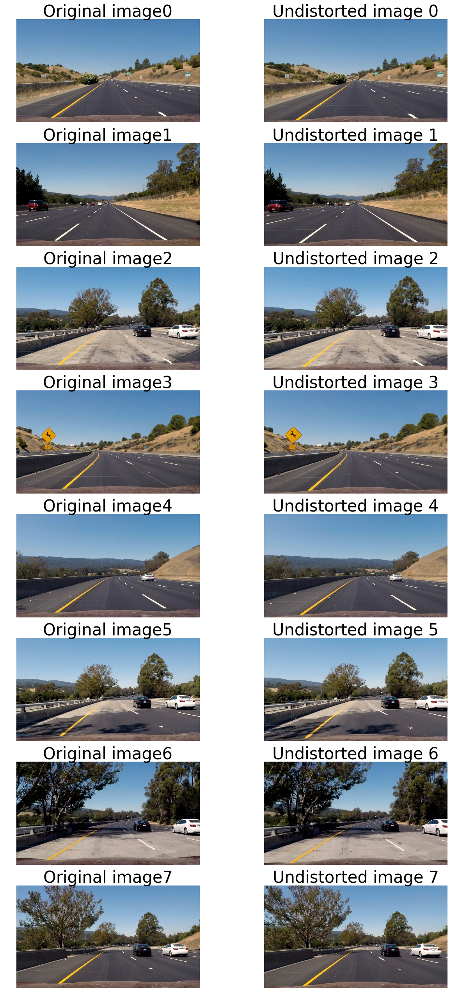

In [11]:
fig, axes = plt.subplots(len(test_images),2, figsize=(8*2, 4*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
#fig.tight_layout()

for i , (image, ax) in enumerate(zip(test_images, axes)):
    undistorted_image = undistort(image)

    ax[0].imshow(image)
    ax[0].set_axis_off()
    xlabel0 = "Original image{0}".format(i)
    ax[0].set_title(xlabel0 , fontsize=30)
    ax[1].imshow(undistorted_image)
    ax[1].set_axis_off()
    xlabel1 = "Undistorted image {0}".format(i)
    ax[1].set_title(xlabel1, fontsize=30)
    ax[1].set_xticks([])
    ax[1].set_yticks([]) 
    
plt.show()
#plt.savefig('./output_images/undistort_output.png')

In [ ]:
fig, axes = plt.subplots(len(chessboard_images),2, figsize=(20, 10*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
fig.tight_layout()
fig.subplots_adjust(hspace=0.2, wspace=0.05)
#fig.tight_layout()

for i , (image, ax) in enumerate(zip(chessboard_images, axes)):
    undistorted_image = undistort(image)

    ax[0].imshow(image)
    ax[0].set_axis_off()
    xlabel0 = "Original image{0}".format(i)
    ax[0].set_title(xlabel0 , fontsize=10)
    ax[1].imshow(undistorted_image)
    ax[1].set_axis_off()
    xlabel1 = "Undistorted image {0}".format(i)
    ax[1].set_title(xlabel1, fontsize=10)
    ax[1].set_xticks([])
    ax[1].set_yticks([]) 
    
#plt.show()

### 2.2 Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image

There are two steps implemented for line detection:

- Detection of lines from undistorted images by a combination:
   - sobel of x on a gray image from HLS channel - detecting lines with horizontal gradients
   
   - two sobel of directions, $arctan({\frac{sobely}{sobelx}})$, from hls channel - as left and right lines within a certain angel ranges

   - combination of the above three - lines_with_gradx AND (left_line OR right_line).

For color thresholding , the L and S channel of HLS images are specially good at detecting bright lines. The s channel for a gradient filter along x and saturation threshold, as well as the l channel for a luminosity threshold filter. A combination of these filters is used in the `binarize_pipeline()` function. This is implemented in `binarize_pipeline()` function 

In [11]:
def binarize_pipeline(img, s_thresh=(120, 255), sx_thresh=(20, 255),  h_thresh=(200, 255), l_thresh=(40,255)):
    #s_thresh=(170, 255), sx_thresh=(80, 100),
    
    img = np.copy(img)
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    '''
    # Threshold color channel
    h_binary = np.zeros_like(h_channel)
    h_binary[(s_channel >= h_thresh[0]) & (s_channel <= h_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, h_binary))

    return color_binary
    '''

    # Threshold lightness
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    channels = 255*np.dstack(( l_binary, sxbinary, s_binary)).astype('uint8')        
    binary = np.zeros_like(sxbinary)
    binary[((l_binary == 1) & (s_binary == 1) | (sxbinary==1))] = 1
    binary = 255*np.dstack((binary,binary,binary)).astype('uint8')   
    
    return  binary,channels
    


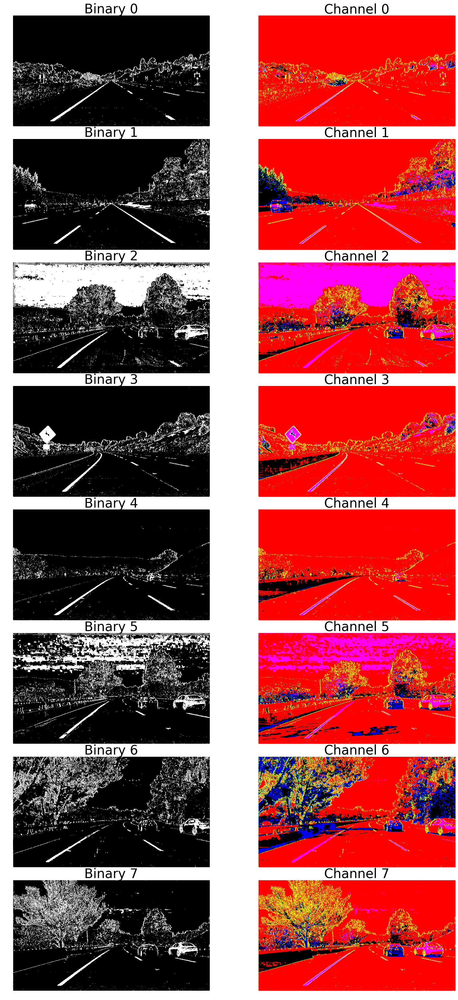

In [12]:
fig, axes = plt.subplots(len(test_images),2, figsize=(8*2, 4*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
fig.tight_layout()

for i , (image, ax) in enumerate(zip(test_images, axes)):
    binary, channels = binarize_pipeline(image)
    ax[0].imshow(binary)
    ax[0].set_axis_off()
    xlabel0 = "Binary {0}".format(i)
    ax[0].set_title(xlabel0 , fontsize=30)
    ax[1].imshow(channels)
    ax[1].set_axis_off()
    xlabel1 = "Channel {0}".format(i)
    ax[1].set_title(xlabel1, fontsize=30)
    ax[1].set_xticks([])
    ax[1].set_yticks([]) 
    
plt.show()
#plt.savefig('./output_images/binarize_pipeline.png')

### 2.3 Perspective transform

The perspective transform to and from "bird's eye" perspective is implemented in `warp()` function. 

- The `warp()` function takes as input an color image (img), as well as the bird_view boolean paramter.

- After esimating the transform matrix, I can transform any new image (original RGB image or simply its binary line image) to a bird-eye view. 

- The parameters src and  dst of the transform are hardcoded in the function as follows:


    'Source' = {[(190, 720), 
                (589, 457), 
                (698, 457), 
                (1145,720)]}
                
    'Destination' = {[(340, 720), 
                     (340, 0), 
                     (995, 0), 
                     (995, 720)]}	


	
	
	
	

In [15]:
def warp(img, nx=9, ny=6, bird_view=True):
    # define 4 destination points dst = np.float32([[,],[,],[,],[,]])
    # use cv2.getPerspectiveTransform() to get M, the transform matrix
    # use cv2.warpPerspective() to warp your image to a top-down view
            
    img_size = (img.shape[1], img.shape[0])

    corners = np.float32([[190,720],[589,457],[698,457],[1145,720]])
    new_top_left=np.array([corners[0,0],0])
    new_top_right=np.array([corners[3,0],0])
    offset=[150,0]
    
    
    src = np.float32([corners[0],corners[1],corners[2],corners[3]])
    dst = np.float32([corners[0]+offset,new_top_left+offset,new_top_right-offset ,corners[3]-offset])
    '''
    offset = 100 # offset for dst points
    img_size = (gray.shape[1], gray.shape[0])
    # For source points I'm grabbing the outer four detected corners
    src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
    # For destination points, I'm arbitrarily choosing some points to be
    # a nice fit for displaying our warped result 
    # again, not exact, but close enough for our purposes
    dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
               
    '''
                
    if bird_view:
        M = cv2.getPerspectiveTransform(src, dst)
    else:
        #Compute the inverse perspective transform:
        M = cv2.getPerspectiveTransform(dst, src)
            
    #Warp an image using 
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
 
    return warped, M

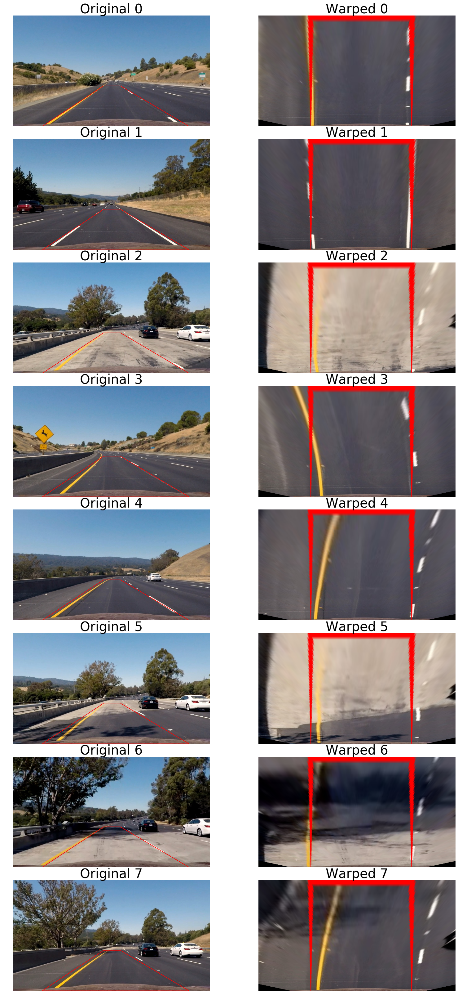

In [16]:
test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]
corners = np.float32([[190,720],[589,457],[698,457],[1145,720]])

corner_tuples=[]
for ind,c in enumerate(corners):
    corner_tuples.append(tuple(corners[ind]))


fig, axes = plt.subplots(len(test_images),2, figsize=(8*2, 4*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
fig.tight_layout()

for i , (image, ax) in enumerate(zip(test_images, axes)):
    image = undistort(image)
    cv2.line(image, corner_tuples[0], corner_tuples[1], color=[255,0,0], thickness=2)
    cv2.line(image, corner_tuples[1], corner_tuples[2], color=[255,0,0], thickness=2)
    cv2.line(image, corner_tuples[2], corner_tuples[3], color=[255,0,0], thickness=2)
    cv2.line(image, corner_tuples[3], corner_tuples[0], color=[255,0,0], thickness=2)    
    warped, _= warp(image, bird_view=True)
    ax[0].imshow(image)
    ax[0].set_axis_off()
    xlabel0 = "Original {0}".format(i)
    ax[0].set_title(xlabel0 , fontsize=30)
    ax[1].imshow(warped)
    ax[1].set_axis_off()
    xlabel1 = "Warped {0}".format(i)
    ax[1].set_title(xlabel1, fontsize=30)
    ax[1].set_xticks([])
    ax[1].set_yticks([]) 
    
plt.show()
#plt.savefig('./output_images/warped_original.png')

In [17]:
def region_of_interest(img):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """    
    shape = img.shape
    vertices = np.array([[(0,0),(shape[1],0),(shape[1],0),(6*shape[1]/7,shape[0]),
                      (shape[1]/7,shape[0]), (0,0)]],dtype=np.int32)

    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image



def warp_pipeline(img):  
    img = undistort(img)
    warped,_ = warp(img)
    warp_roi = region_of_interest(warped)
    return warp_roi


def warp_binary_pipeline(img): 
    img = undistort(img)
    binary,_ = binarize_pipeline(img)
    binary_warped,_ = warp(binary)
    binary_warped_roi = region_of_interest(binary_warped)
    return binary_warped_roi
    

To reduce artefacts at the bottom of the image, a region of interest is implemented to act on the warped image  This region is defined through the function `region_of_interest()` and is tested using the wrappers `warp_pipeline(img)` and `warp_binary_pipeline(img)`. The result is shown below.

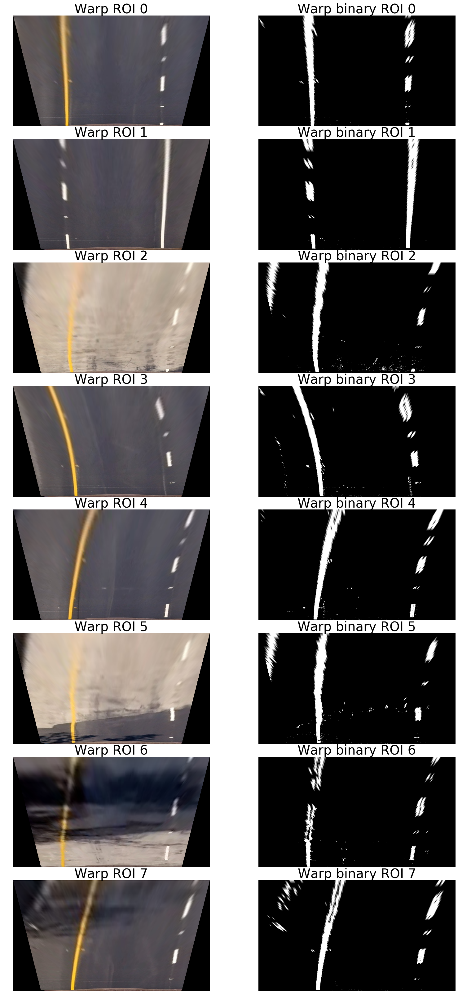

In [18]:
test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]

fig, axes = plt.subplots(len(test_images),2, figsize=(8*2, 4*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
fig.tight_layout()

for i , (image, ax) in enumerate(zip(test_images, axes)):
    #cv2.line(image, corner_tuples[0], corner_tuples[1], color=[255,0,0], thickness=2)
    #cv2.line(image, corner_tuples[1], corner_tuples[2], color=[255,0,0], thickness=2)
    #cv2.line(image, corner_tuples[2], corner_tuples[3], color=[255,0,0], thickness=2)
    #cv2.line(image, corner_tuples[3], corner_tuples[0], color=[255,0,0], thickness=2)
    warped_roi = warp_pipeline(image)
    binary_warped_roi = warp_binary_pipeline(image)
    binary
    ax[0].imshow(warped_roi)
    ax[0].set_axis_off()
    xlabel0 = "Warp ROI {0}".format(i)
    ax[0].set_title(xlabel0 , fontsize=30)
    ax[1].imshow(binary_warped_roi)
    ax[1].set_axis_off()
    xlabel1 = "Warp binary ROI {0}".format(i)
    ax[1].set_title(xlabel1, fontsize=30)
    ax[1].set_xticks([])
    ax[1].set_yticks([]) 
    
plt.show()
#plt.savefig('./output_images/warp_roi.png')

### 2.4  Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

The same techniques can be used to detect the lane pixels in the warped images. 

 - The function `find_peaks(img,thresh)` takes the bottom half of a binarized and warped lane image to compute a histogram of detected pixel values. The result is smoothened using a gaussian filter and peaks are subsequently detected using. The function returns the x values of the peaks larger than thresh as well as the smoothened curve.

 - The next function `get_next_window(img,center_point,width)` which takes an binary (3 channel) image and computes the average x value center of all detected pixels in a window centered at center_point of width width. It returns a masked copy of img a well as center.

 - The function `lane_from_window(binary,center_point,width)` slices a binary image horizontally in 6 zones and applies get_next_window to each of the zones. The center_point of each zone is chosen to be the center value of the previous zone. Thereby subsequent windows follow the lane line pixels if the road bends. The function returns a masked image of a single lane line seeded at center_point. Given a binary image left_binary of a lane line candidate all properties of the line are determined within an instance of a Line class.

- The Line.update(img) method takes a binary input image of a lane line candidate, fits a second order polynomial to the provided data and computes other metrics. Sanity checks are performed and successful detections are pushed into a FIFO que of max length n. Each time a new line is detected all metrics are updated. If no line is detected the oldest result is dropped until the queue is empty and peaks need to be searched for from scratch.

- A fit to the current lane candidate is saved in the Line.current_fit_xvals attribute, together with the corresponding coefficients. 

The results of the lane pixels in the bird-eye view are shown below. We can see there are some noises in the final lane images, which need to be removed before parameter estimation.

In [13]:
def find_peaks(img,thresh):
    img_half=img[img.shape[0]/2:,:,0]
    data = np.sum(img_half, axis=0)
    filtered = scipy.ndimage.filters.gaussian_filter1d(data,20)
    xs = np.arange(len(filtered))
    peak_ind = signal.find_peaks_cwt(filtered, np.arange(20,300))
    peaks = np.array(peak_ind)
    peaks = peaks[filtered[peak_ind]>thresh]
    return peaks,filtered


def get_next_window(img,center_point,width):
    """
    input: img,center_point,width
        img: binary 3 channel image
        center_point: center of window
        width: width of window
    
    output: masked,center_point
        masked : a masked image of the same size. mask is a window centered at center_point
        center : the mean ofall pixels found within the window
    """
    
    ny,nx,_ = img.shape
    mask  = np.zeros_like(img)
    if (center_point <= width/2): center_point = width/2
    if (center_point >= nx-width/2): center_point = nx-width/2
    
    left  = center_point - width/2
    right = center_point + width/2
    
    vertices = np.array([[(left,0),(left,ny), (right,ny),(right,0)]], dtype=np.int32)
    ignore_mask_color=(255,255,255)
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    masked = cv2.bitwise_and(mask,img)

    hist = np.sum(masked[:,:,0],axis=0)
    if max(hist>10000):
        center = np.argmax(hist)
    else:
        center = center_point
        
    return masked,center

def lane_from_window(binary,center_point,width):
    n_zones=6
    ny,nx,nc = binary.shape
    zones = binary.reshape(n_zones,-1,nx,nc)
    zones = zones[::-1] # start from the bottom slice
    window,center = get_next_window(zones[0],center_point,width)
    
    for zone in zones[1:]:
        next_window,center = get_next_window(zone,center,width)
        window = np.vstack((next_window,window))
    
    return window

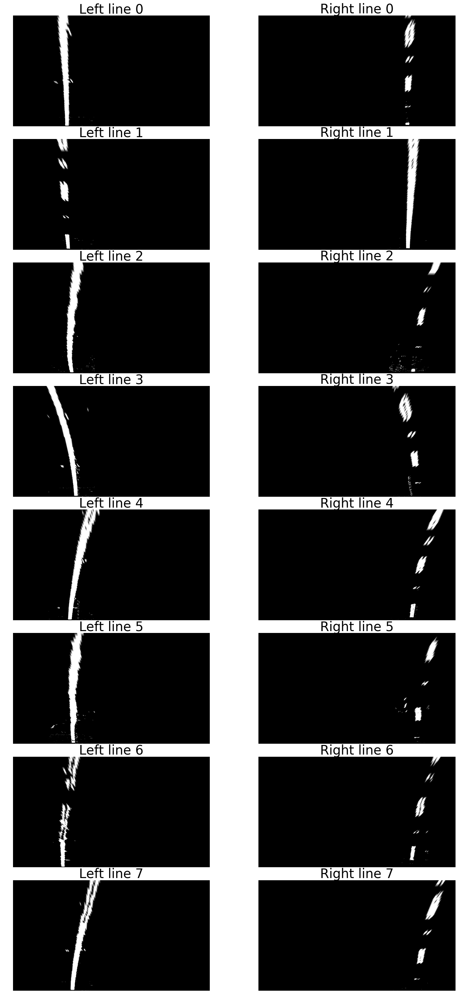

In [20]:
test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]

fig, axes = plt.subplots(len(test_images),2, figsize=(8*2, 4*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
fig.tight_layout()

for i , (image, ax) in enumerate(zip(test_images, axes)):
    #warped_roi = warp_pipeline(image)
    binary_warped = warp_binary_pipeline(image)
    left_binary = lane_from_window(binary_warped,380,300)
    right_binary = lane_from_window(binary_warped,1000,300)
    binary
    ax[0].imshow(left_binary)
    ax[0].set_axis_off()
    xlabel0 = "Left line {0}".format(i)
    ax[0].set_title(xlabel0 , fontsize=30)
    ax[1].imshow(right_binary)
    ax[1].set_axis_off()
    xlabel1 = "Right line {0}".format(i)
    ax[1].set_title(xlabel1, fontsize=30)
    ax[1].set_xticks([])
    ax[1].set_yticks([]) 
    
plt.show()
#plt.savefig('./output_images/left_right_lines.png')

In [21]:
'''
import numpy as np
import cv2
import matplotlib.pyplot as plt

binary_warped = binary_warped_roi
# Assuming you have created a warped binary image called "binary_warped"
# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)
'''

'\nimport numpy as np\nimport cv2\nimport matplotlib.pyplot as plt\n\nbinary_warped = binary_warped_roi\n# Assuming you have created a warped binary image called "binary_warped"\n# Take a histogram of the bottom half of the image\nhistogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)\n# Create an output image to draw on and  visualize the result\nout_img = np.dstack((binary_warped, binary_warped, binary_warped))*255\n# Find the peak of the left and right halves of the histogram\n# These will be the starting point for the left and right lines\nmidpoint = np.int(histogram.shape[0]/2)\nleftx_base = np.argmax(histogram[:midpoint])\nrightx_base = np.argmax(histogram[midpoint:]) + midpoint\n\n# Choose the number of sliding windows\nnwindows = 9\n# Set height of windows\nwindow_height = np.int(binary_warped.shape[0]/nwindows)\n# Identify the x and y positions of all nonzero pixels in the image\nnonzero = binary_warped.nonzero()\nnonzeroy = np.array(nonzero[0])\nnonzerox = np.

### 2.5 Lane parameter estimation

we have the lane pixels in bird-eye view and meter-per-pixel for both x and y, estimating the curvature and the center offset is straightforward. The whole process is implemented in `Line.get_radius_of_curvature()` method:


- After getting pixels for each lane, a 2nd order polynomial is fit for each lane, based on which the radius of curvature and center offset are caculated in `Line.get_radius_of_curvature()` method. The radius of curvature is computed upon calling the `Line.update()` method of Line Class. 


-  For a second order polynomial $f(y)=A y^2 +B y + C$ the radius of curvature is given by $R = {{(1+(2 Ay +B)^2 )^{3/2}} \over {2|A|}}$. The mathematics involved is summarized in [this tutorial here](http://www.intmath.com/applications-differentiation/8-radius-curvature.php).


- The distance from the center of the lane is computed in the Line.set_line_base_pos() method, which essentially measures the distance to each lane and computes the position assuming the lane has a given fixed width of 3.7m. 


- The estimated 2nd polynoimal approximation of lanes are overlayed onto the image for furthure visual check.





In [24]:
# Define a class to receive the characteristics of each line detection
class Line:
    def __init__(self,n=5):
        # length of queue to store data
        self.n = n
        #number of fits in buffer
        self.n_buffered = 0
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = deque([],maxlen=n)
        #average x values of the fitted line over the last n iterations
        self.avgx = None
        # fit coeffs of the last n fits
        self.recent_fit_coeffs = deque([],maxlen=n)        
        #polynomial coefficients averaged over the last n iterations
        self.avg_fit_coeffs = None  
        # xvals of the most recent fit
        self.current_fit_xvals = [np.array([False])]  
        #polynomial coefficients for the most recent fit
        self.current_fit_coeffs = [np.array([False])]          
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        #y values for line fit
        self.fit_yvals = np.linspace(0, 100, num=101)*7.2  # always the same y-range as image
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        # origin (pixels) of fitted line at the bottom of the image
        self.line_pos = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 

    def set_current_fit_xvals(self):
        yvals = self.fit_yvals
        self.current_fit_xvals = self.current_fit_coeffs[0]*yvals**2 + self.current_fit_coeffs[1]*yvals + self.current_fit_coeffs[2]
        
    def add_data(self):
        self.recent_xfitted.appendleft(self.current_fit_xvals)
        self.recent_fit_coeffs.appendleft(self.current_fit_coeffs)
        assert len(self.recent_xfitted)==len(self.recent_fit_coeffs)
        self.n_buffered = len(self.recent_xfitted)
        
    def pop_data(self):        
        if self.n_buffered>0:
            self.recent_xfitted.pop()
            self.recent_fit_coeffs.pop()
            assert len(self.recent_xfitted)==len(self.recent_fit_coeffs)
            self.n_buffered = len(self.recent_xfitted)
        
        return self.n_buffered
        
    def set_avgx(self):
        fits = self.recent_xfitted
        if len(fits)>0:
            avg=0
            for fit in fits:
                avg +=np.array(fit)
            avg = avg / len(fits)
            self.avgx = avg
            
    def set_avgcoeffs(self):
        coeffs = self.recent_fit_coeffs
        if len(coeffs)>0:
            avg=0
            for coeff in coeffs:
                avg +=np.array(coeff)
            avg = avg / len(coeffs)
            self.avg_fit_coeffs = avg
    
    def set_allxy(self,lane_candidate):
        self.ally,self.allx = (lane_candidate[:,:,0]>254).nonzero()

    def set_current_fit_coeffs(self):
        self.current_fit_coeffs = np.polyfit(self.ally, self.allx, 2)
    
    def get_diffs(self):
        if self.n_buffered>0:
            self.diffs = self.current_fit_coeffs - self.avg_fit_coeffs
        else:
            self.diffs = np.array([0,0,0], dtype='float')                 
            
    def set_radius_of_curvature(self):
        # Define y-value where we want radius of curvature (choose bottom of the image)
        y_eval = max(self.fit_yvals)
        if self.avg_fit_coeffs is not None:
            self.radius_of_curvature = ((1 + (2*self.avg_fit_coeffs[0]*y_eval + self.avg_fit_coeffs[1])**2)**1.5) \
                             /np.absolute(2*self.avg_fit_coeffs[0])
                        
            
    def set_line_base_pos(self):
        y_eval = max(self.fit_yvals)
        self.line_pos = self.current_fit_coeffs[0]*y_eval**2 \
                        +self.current_fit_coeffs[1]*y_eval \
                        + self.current_fit_coeffs[2]
        basepos = 640
        
        self.line_base_pos = (self.line_pos - basepos)*3.7/600.0 # 3.7 meters is about 600 pixels in the x direction

    # here come sanity checks of the computed metrics
    def accept_lane(self):
        flag = True
        maxdist = 2.8  # distance in meters from the lane
        if(abs(self.line_base_pos) > maxdist ):
            print('lane too far away')
            flag  = False        
        if(self.n_buffered > 0):
            relative_delta = self.diffs / self.avg_fit_coeffs
            # allow maximally this percentage of variation in the fit coefficients from frame to frame
            if not (abs(relative_delta)<np.array([0.7,0.5,0.15])).all():
                print('fit coeffs too far off [%]',relative_delta)
                flag=False
                
        return flag
    
    def update(self,lane):
        self.set_allxy(lane)
        self.set_current_fit_coeffs()
        self.set_current_fit_xvals()
        self.set_radius_of_curvature()
        self.set_line_base_pos()
        self.get_diffs()
        if self.accept_lane():
            self.detected=True
            self.add_data()
            self.set_avgx()
            self.set_avgcoeffs()            
        else:
            self.detected=False            
            self.pop_data()
            if self.n_buffered>0:
                self.set_avgx()
                self.set_avgcoeffs()
                    
        return self.detected,self.n_buffered
    
def get_binary_lane_image(img,line,window_center,width=300):
    if line.detected:
        window_center=line.line_pos
    else:
        peaks,filtered = find_peaks(img,thresh=3000)
        if len(peaks)!=2:
            print('Trouble ahead! '+ str(len(peaks)) +' lanes detected!')
            plt.imsave('troublesome_image.jpg',img)                        
            
        peak_ind = np.argmin(abs(peaks-window_center))
        peak  = peaks[peak_ind]
        window_center = peak
    
    lane_binary = lane_from_window(img,window_center,width)
    return lane_binary

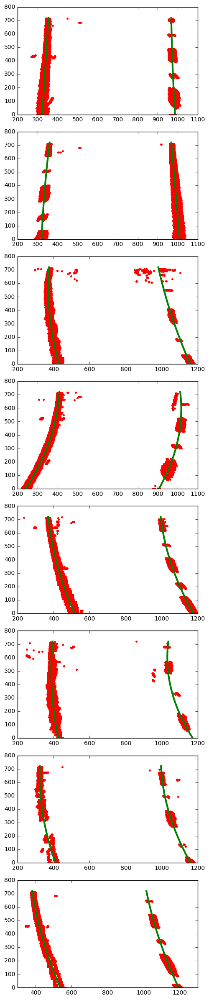

In [25]:
test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]

fig, axes = plt.subplots(len(test_images),1, figsize=(5, 3*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
fig.tight_layout()

for i , (image, ax) in enumerate(zip(test_images, axes)):
    left=Line()
    right=Line()
    binary_warped = warp_binary_pipeline(image)
    left_binary = lane_from_window(binary_warped,380,300)
    right_binary = lane_from_window(binary_warped,1000,300)

    detected_l,n_buffered_left = left.update(left_binary)
    detected_r,n_buffered_right = right.update(right_binary)

    leftx = left.allx
    left_fitx = left.current_fit_xvals
    yvals_l = left.ally

    rightx = right.allx
    right_fitx = right.current_fit_xvals
    yvals_r = right.ally

    yvals = left.fit_yvals

    ax.plot(rightx, yvals_r, '.', color='red')
    ax.plot(right_fitx, yvals, color='green', linewidth=3)

    ax.plot(leftx, yvals_l, '.', color='red')
    ax.plot(left_fitx, yvals, color='green', linewidth=3)
    
plt.show()
#plt.savefig('./output_images/fitted_lines.png')

### 2.6 Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

In [30]:
def project_lane_lines(img,left_fitx,right_fitx,yvals):
    
    # Create an image to draw the lines on
    color_warp = np.zeros_like(img).astype(np.uint8)

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, yvals]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, yvals])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.polylines(color_warp, np.int_([pts]), isClosed=False, color=(255,0,0), thickness=20)
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    
        
    undist = undistort(img)  
    sp = (550, 310) 
    ep = (700, 460)
    for i in range(4):
        center = ((ep[0] + sp[0])/2 , )
        cv2.rectangle(undist, (550, 310), (700, 460), (0,0,255), 4)
    unwarp,Minv = warp(img,bird_view=False)

    

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    return result

test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]
img = test_images [0]

global left
global right
undist = undistort(img)
binary,_  = binarize_pipeline(undist)
warped,_  = warp(binary)
warped_binary = region_of_interest(warped)
    
window_center_l = 340
if left.detected:
    window_center_l = left.line_pos        
left_binary = get_binary_lane_image(warped_binary,left,window_center_l,width=300)

window_center_r = 940
if right.detected:
    window_center_r = right.line_pos        
right_binary = get_binary_lane_image(warped_binary,right,window_center_r,width=300)
    
detected_l,n_buffered_left = left.update(left_binary)
detected_r,n_buffered_right = right.update(right_binary)    
    
left_fitx = left.avgx
right_fitx = right.avgx
yvals = left.fit_yvals
lane_width = 3.7

pts_left = np.array([np.transpose(np.vstack([left_fitx, yvals]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, yvals])))])
print(pts_left[0][:])
print(pts_right[0][:])

test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]
img = test_images [0]
x1 = int(pts_left[0][50][0])
y1 = int(pts_left[0][50][1]) - 200
x2 = int(pts_right[0][50][0])
y2 = int(pts_right[0][50][1]) + 100

cv2.rectangle(img, (x1, y1), (x2, y2), (0,0,255), 4)
plt.imshow(img)

x, y = pts_left[0][40]
x1, y1 = pts_right[0][40]
print(x, y, x1, y1)

In [31]:
def process_image(img):
    global left
    global right
    undist = undistort(img)
    binary,_  = binarize_pipeline(undist)
    warped,_  = warp(binary)
    warped_binary = region_of_interest(warped)
    
    window_center_l = 340
    if left.detected:
        window_center_l = left.line_pos        
    left_binary = get_binary_lane_image(warped_binary,left,window_center_l,width=300)
    
    window_center_r = 940
    if right.detected:
        window_center_r = right.line_pos        
    right_binary = get_binary_lane_image(warped_binary,right,window_center_r,width=300)
    
    detected_l,n_buffered_left = left.update(left_binary)
    detected_r,n_buffered_right = right.update(right_binary)    
    
    left_fitx = left.avgx
    right_fitx = right.avgx
    yvals = left.fit_yvals
    lane_width = 3.7
    off_center = -100*round(0.5*(right.line_base_pos-lane_width/2) +  0.5*(abs(left.line_base_pos)-lane_width/2),2)
    
    result = project_lane_lines(img,left_fitx,right_fitx,yvals)
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    str1 = str('distance from center: '+str(off_center)+'cm')
    cv2.putText(result,str1,(430,630), font, 1,(0,0,255),2,cv2.LINE_AA)
    if left.radius_of_curvature and right.radius_of_curvature:
        curvature = 0.5*(round(right.radius_of_curvature/1000,1) + round(left.radius_of_curvature/1000,1))
        str2 = str('radius of curvature: '+str(curvature)+'km')
        cv2.putText(result,str2,(430,670), font, 1,(0,0,255),2,cv2.LINE_AA)    
    
    return result

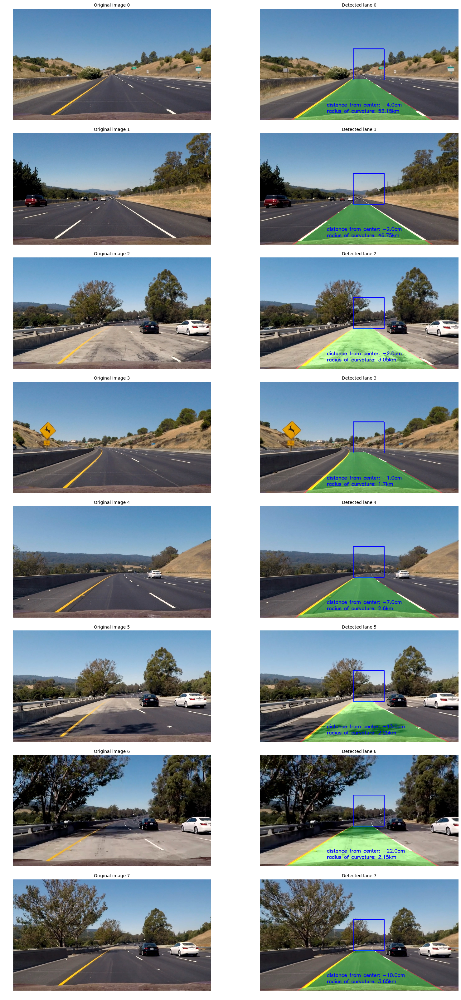

In [32]:
test_images = [mpimg.imread(f) for f in glob.glob('./test_images/*.jpg')]

fig, axes = plt.subplots(len(test_images),2, figsize=(8*2, 4*len(test_images)))
fig.subplots_adjust(hspace=0.2, wspace=0.05)
fig.tight_layout()

for i , (image, ax) in enumerate(zip(test_images, axes)):
    left = Line()
    right = Line()
    result = process_image(image)
    result = process_image(image)

    ax[0].imshow(image)
    ax[0].set_axis_off()
    xlabel0 = "Original image {0}".format(i)
    ax[0].set_title(xlabel0 , fontsize=10)
    ax[1].imshow(result)
    ax[1].set_axis_off()
    xlabel1 = "Detected lane {0}".format(i)
    ax[1].set_title(xlabel1, fontsize=10)
    ax[1].set_xticks([])
    ax[1].set_yticks([]) 
    
plt.show()
#plt.savefig('./output_images/detected_lane.png')

# 3. Pipeline for video

The processed project video can be found here.

The result on project_video.mp4 is shown below. The algorithm works did not work on the two challenge videos. I didn't go further to modify the code to work on these challenges. As mentioned above, I am not really convinced by the material in this project, so even it succeeds on the challenge videos, I have no confidence at all that it will work on new scenarios.

In [49]:
output_dir= './output_images/'
clip_input_file = 'project_video.mp4'
clip_output_file = output_dir +'sample_' + clip_input_file
clip = VideoFileClip(clip_input_file).subclip(30, 40)
clip_output = clip.fl_image(process_image)
%time clip_output.write_videofile(clip_output_file, audio=False)


fit coeffs too far off [%] [ 0.93940061  0.38272121  0.02795677]
[MoviePy] >>>> Building video ./output_images/sample_project_video.mp4
[MoviePy] Writing video ./output_images/sample_project_video.mp4


  0%|          | 1/251 [00:00<03:27,  1.20it/s]

fit coeffs too far off [%] [ 0.93940061  0.38272121  0.02795677]


 22%|██▏       | 54/251 [00:13<00:43,  4.53it/s]

fit coeffs too far off [%] [-0.72497623 -0.33740079 -0.02477769]


 25%|██▍       | 62/251 [00:15<00:43,  4.33it/s]

fit coeffs too far off [%] [ 0.93009753  0.37900098  0.01708366]


 26%|██▌       | 65/251 [00:16<00:55,  3.34it/s]

fit coeffs too far off [%] [ 0.74000733  0.40321006  0.0144851 ]


 54%|█████▍    | 135/251 [00:32<00:26,  4.40it/s]

fit coeffs too far off [%] [ 0.74219292  0.14796921 -0.00198095]


 59%|█████▊    | 147/251 [00:35<00:22,  4.55it/s]

fit coeffs too far off [%] [-1.00262256 -0.43357883 -0.02198018]


 59%|█████▉    | 148/251 [00:36<00:38,  2.71it/s]

fit coeffs too far off [%] [-0.99620672 -0.45500608 -0.02622946]


 91%|█████████ | 228/251 [00:53<00:05,  4.57it/s]

fit coeffs too far off [%] [ 0.97928746  0.25321604  0.01689819]


 91%|█████████ | 229/251 [00:54<00:08,  2.56it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-1.56657601 -0.5475463  -0.03354967]


 92%|█████████▏| 230/251 [00:55<00:11,  1.91it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-1.10464082 -0.43259549 -0.02906233]


 92%|█████████▏| 231/251 [00:56<00:12,  1.60it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-4.9926635  -1.75286975 -0.08954981]


 92%|█████████▏| 232/251 [00:56<00:13,  1.45it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-1.00370619 -0.41404662 -0.02746571]


 93%|█████████▎| 233/251 [00:57<00:13,  1.35it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-2.69188939 -1.2205833  -0.07008208]


 93%|█████████▎| 234/251 [00:58<00:13,  1.28it/s]

Trouble ahead! 3 lanes detected!


 94%|█████████▎| 235/251 [00:58<00:09,  1.61it/s]

fit coeffs too far off [%] [-1.56424987 -3.57206973  0.07269133]


 94%|█████████▍| 237/251 [01:00<00:08,  1.72it/s]

fit coeffs too far off [%] [ 0.81918727  0.27723144 -0.01383659]


 95%|█████████▍| 238/251 [01:01<00:09,  1.43it/s]

fit coeffs too far off [%] [ 1.32480723  0.75136935  0.02800127]


 95%|█████████▌| 239/251 [01:01<00:08,  1.34it/s]

fit coeffs too far off [%] [ 0.70760885  0.29556336 -0.01487867]


 96%|█████████▌| 241/251 [01:02<00:05,  1.67it/s]

fit coeffs too far off [%] [ 0.89593895  0.49446644 -0.00675978]


 96%|█████████▋| 242/251 [01:03<00:05,  1.53it/s]

fit coeffs too far off [%] [ 0.71037197  0.35662967 -0.02338739]


 97%|█████████▋| 243/251 [01:04<00:05,  1.48it/s]

fit coeffs too far off [%] [ 0.9151953   0.73251881  0.02034192]


 99%|█████████▉| 249/251 [01:06<00:00,  3.54it/s]

fit coeffs too far off [%] [-0.73890976 -0.39507065 -0.01928815]


100%|█████████▉| 250/251 [01:06<00:00,  2.43it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_images/sample_project_video.mp4 

CPU times: user 1min 14s, sys: 13.9 s, total: 1min 28s
Wall time: 1min 7s


In [53]:
output_dir= './output_images/'
clip_input_file = 'project_video.mp4'
clip_output_file = output_dir +'processed_' + clip_input_file
clip = VideoFileClip(clip_input_file)
clip_output = clip.fl_image(process_image)
%time clip_output.write_videofile(clip_output_file, audio=False)

fit coeffs too far off [%] [-2.82842795 -2.30035987 -0.5493272 ]
fit coeffs too far off [%] [-2.97057816 -2.02411921 -0.23496604]
[MoviePy] >>>> Building video ./output_images/processed_project_video.mp4
[MoviePy] Writing video ./output_images/processed_project_video.mp4


  0%|          | 1/1261 [00:01<30:07,  1.43s/it]

fit coeffs too far off [%] [-2.83809212 -2.3021391  -0.54929279]
fit coeffs too far off [%] [-2.95509366 -2.020194   -0.23482248]


  1%|          | 14/1261 [00:06<06:18,  3.30it/s]

fit coeffs too far off [%] [ 1.47627671  0.39214548 -0.01938875]


  1%|          | 15/1261 [00:06<09:54,  2.10it/s]

fit coeffs too far off [%] [ 1.29957273  0.45445129 -0.04149342]


  1%|▏         | 16/1261 [00:07<12:10,  1.70it/s]

fit coeffs too far off [%] [ 1.04026609  0.43515249 -0.0536499 ]


  1%|▏         | 17/1261 [00:08<14:19,  1.45it/s]

fit coeffs too far off [%] [ 0.85278743  0.43009612 -0.05920079]


  1%|▏         | 18/1261 [00:09<15:53,  1.30it/s]

fit coeffs too far off [%] [ 0.99895394  0.47838792 -0.06434185]


  6%|▌         | 74/1261 [00:24<05:09,  3.83it/s]

fit coeffs too far off [%] [ 0.75808758  0.27825732 -0.01370621]


  7%|▋         | 84/1261 [00:27<04:55,  3.99it/s]

fit coeffs too far off [%] [-0.90727964 -0.42691135  0.03728319]


  9%|▉         | 114/1261 [00:35<04:21,  4.38it/s]

fit coeffs too far off [%] [ 0.87049133  0.48796437 -0.02976857]


 12%|█▏        | 148/1261 [00:44<04:50,  3.83it/s]

fit coeffs too far off [%] [ 1.01855496  0.44633841 -0.04007448]


 12%|█▏        | 149/1261 [00:45<08:11,  2.26it/s]

fit coeffs too far off [%] [ 1.05977904  0.47926436 -0.04286696]


 12%|█▏        | 150/1261 [00:46<10:34,  1.75it/s]

fit coeffs too far off [%] [ 0.78328406  0.33892425 -0.0270544 ]


 12%|█▏        | 151/1261 [00:47<14:10,  1.30it/s]

fit coeffs too far off [%] [ 0.77992014  0.3105466  -0.02101002]


 12%|█▏        | 152/1261 [00:48<15:16,  1.21it/s]

fit coeffs too far off [%] [ 0.75928427  0.28940407 -0.01765134]


 14%|█▎        | 171/1261 [00:54<04:41,  3.87it/s]

fit coeffs too far off [%] [ 0.80391659  0.20075695  0.00692376]


 14%|█▎        | 172/1261 [00:55<07:19,  2.48it/s]

fit coeffs too far off [%] [ 1.16374777  0.35613299 -0.00687437]


 14%|█▎        | 173/1261 [00:55<09:22,  1.93it/s]

fit coeffs too far off [%] [ 1.23536558  0.47480135 -0.02986708]


 14%|█▍        | 174/1261 [00:56<10:58,  1.65it/s]

fit coeffs too far off [%] [ 1.75530451  0.81508894 -0.07390674]


 14%|█▍        | 175/1261 [00:57<11:46,  1.54it/s]

fit coeffs too far off [%] [ 1.88950818  0.95971499 -0.09439478]


 24%|██▍       | 305/1261 [01:27<03:35,  4.44it/s]

fit coeffs too far off [%] [-1.7244893  -0.68923361  0.02494472]


 24%|██▍       | 306/1261 [01:28<05:58,  2.66it/s]

fit coeffs too far off [%] [-1.74865042 -0.61413011  0.01000787]


 24%|██▍       | 307/1261 [01:28<07:38,  2.08it/s]

fit coeffs too far off [%] [-1.26487971 -0.52285725  0.01772534]


 25%|██▍       | 311/1261 [01:30<05:21,  2.95it/s]

fit coeffs too far off [%] [-0.87596489 -0.31165661  0.00505638]


 25%|██▍       | 312/1261 [01:31<07:11,  2.20it/s]

fit coeffs too far off [%] [-0.79829649 -0.31887085  0.00932831]


 25%|██▍       | 314/1261 [01:31<07:03,  2.24it/s]

fit coeffs too far off [%] [-0.89584212 -0.41283244  0.06187083]
fit coeffs too far off [%] [-0.72367177 -0.28825891  0.00969208]


 25%|██▌       | 316/1261 [01:33<08:30,  1.85it/s]

fit coeffs too far off [%] [-1.21392041 -0.41588381  0.0430218 ]


 25%|██▌       | 318/1261 [01:34<07:35,  2.07it/s]

fit coeffs too far off [%] [-0.78183334 -0.39751208  0.05401351]
fit coeffs too far off [%] [  2.54707393e+00   4.18645478e-01  -1.78649676e-03]


 25%|██▌       | 319/1261 [01:35<11:06,  1.41it/s]

fit coeffs too far off [%] [-1.28282137 -0.41552737  0.04401542]
fit coeffs too far off [%] [  3.78697480e+00   6.26427341e-01   2.48789624e-03]


 25%|██▌       | 320/1261 [01:36<13:30,  1.16it/s]

fit coeffs too far off [%] [-2.67012555 -0.67914     0.06141238]
fit coeffs too far off [%] [ 2.52478961  0.66983794 -0.01029156]


 25%|██▌       | 321/1261 [01:38<15:07,  1.04it/s]

fit coeffs too far off [%] [-3.74343325 -0.68266684  0.05577087]
fit coeffs too far off [%] [ 1.96532376  0.54725865 -0.00478418]


 26%|██▌       | 322/1261 [01:39<16:46,  1.07s/it]

fit coeffs too far off [%] [-5.31839443 -0.81551752  0.06559223]
fit coeffs too far off [%] [ 0.71120146  0.35576182 -0.00654658]


 26%|██▌       | 324/1261 [01:40<13:13,  1.18it/s]

fit coeffs too far off [%] [-0.13982705  0.73239849 -0.0199691 ]


 26%|██▌       | 329/1261 [01:42<05:38,  2.75it/s]

fit coeffs too far off [%] [-0.19574513  0.80320398 -0.03283045]


 26%|██▌       | 330/1261 [01:43<07:16,  2.13it/s]

fit coeffs too far off [%] [-0.61384796  0.78865895 -0.01441537]
fit coeffs too far off [%] [-1.16765882 -0.68016642  0.01379163]


 26%|██▌       | 331/1261 [01:44<10:43,  1.45it/s]

fit coeffs too far off [%] [-1.02136003  0.66091589  0.00181827]


 26%|██▋       | 332/1261 [01:45<10:51,  1.43it/s]

fit coeffs too far off [%] [-1.23861615  0.18646278  0.03259051]


 26%|██▋       | 334/1261 [01:45<08:42,  1.77it/s]

fit coeffs too far off [%] [ -1.27204765e+00   1.12519610e+01  -9.79533346e-03]
fit coeffs too far off [%] [-0.79048065 -0.25895446 -0.00840801]


 27%|██▋       | 335/1261 [01:47<11:44,  1.31it/s]

fit coeffs too far off [%] [-0.78150808 -0.25507432 -0.00723979]


 27%|██▋       | 336/1261 [01:47<11:34,  1.33it/s]

fit coeffs too far off [%] [-1.38506835  0.61486965 -0.02995599]
fit coeffs too far off [%] [-0.66438249 -0.53863292  0.02272223]


 27%|██▋       | 337/1261 [01:49<13:46,  1.12it/s]

fit coeffs too far off [%] [-1.26458123 -0.84807637  0.03607314]


 27%|██▋       | 338/1261 [01:49<12:58,  1.19it/s]

fit coeffs too far off [%] [  2.12450281e+00  -1.29160535e-01  -9.43019161e-04]
fit coeffs too far off [%] [-0.78470252 -0.70565078  0.03683969]


 27%|██▋       | 340/1261 [01:51<11:19,  1.35it/s]

fit coeffs too far off [%] [ 1.45664093 -1.74220066  0.03081401]
fit coeffs too far off [%] [-0.71524939 -0.00176518 -0.00745566]


 27%|██▋       | 342/1261 [01:52<10:26,  1.47it/s]

fit coeffs too far off [%] [-0.11695536  1.04896536  0.02760646]
fit coeffs too far off [%] [-2.76201059  5.5486367  -0.02253848]


 27%|██▋       | 345/1261 [01:54<08:02,  1.90it/s]

fit coeffs too far off [%] [-0.09440818 -1.53368086 -0.01715952]


 27%|██▋       | 346/1261 [01:55<08:57,  1.70it/s]

fit coeffs too far off [%] [-0.36827287 -3.65346397 -0.02688158]
fit coeffs too far off [%] [-0.49045859 -0.52870574  0.01725563]


 28%|██▊       | 348/1261 [01:56<09:16,  1.64it/s]

fit coeffs too far off [%] [-0.40451378  0.64835203 -0.01786095]
fit coeffs too far off [%] [-0.60691652 -0.64861867  0.01673304]


 28%|██▊       | 349/1261 [01:57<12:32,  1.21it/s]

fit coeffs too far off [%] [-1.03742888 -0.77234892  0.01030861]


 28%|██▊       | 350/1261 [01:58<12:19,  1.23it/s]

fit coeffs too far off [%] [-1.05637221 -1.03507981  0.01711981]


 28%|██▊       | 351/1261 [01:59<12:28,  1.22it/s]

fit coeffs too far off [%] [ 1.16140685  0.31098891 -0.00745258]


 28%|██▊       | 352/1261 [02:00<13:20,  1.14it/s]

fit coeffs too far off [%] [ 2.75440981  0.55039857 -0.00846207]
fit coeffs too far off [%] [-0.76523181 -0.81264733  0.00269445]


 28%|██▊       | 354/1261 [02:02<12:49,  1.18it/s]

fit coeffs too far off [%] [ -1.31606233e+00  -1.86674384e+00  -1.37305760e-03]


 28%|██▊       | 356/1261 [02:03<10:13,  1.47it/s]

fit coeffs too far off [%] [-2.44504354 -0.78064707 -0.00270293]


 28%|██▊       | 359/1261 [02:04<07:07,  2.11it/s]

fit coeffs too far off [%] [-1.0228656  -0.61187652  0.03901819]


 29%|██▊       | 360/1261 [02:05<08:15,  1.82it/s]

fit coeffs too far off [%] [-1.187795   -0.63522655  0.03209875]


 29%|██▊       | 361/1261 [02:06<09:02,  1.66it/s]

fit coeffs too far off [%] [-1.66485101 -0.85835544  0.0352003 ]


 29%|██▊       | 362/1261 [02:07<09:36,  1.56it/s]

fit coeffs too far off [%] [-2.41181322 -1.30564466  0.05704472]


 29%|██▉       | 363/1261 [02:07<09:58,  1.50it/s]

fit coeffs too far off [%] [-2.93046165 -1.48653074  0.06718577]


 29%|██▉       | 366/1261 [02:08<06:42,  2.22it/s]

fit coeffs too far off [%] [ 0.76205241  0.75999731 -0.00910979]


 29%|██▉       | 367/1261 [02:09<07:58,  1.87it/s]

fit coeffs too far off [%] [ 1.7193649   1.06111404 -0.00424145]


 30%|██▉       | 372/1261 [02:11<04:36,  3.21it/s]

fit coeffs too far off [%] [-1.10751618 -1.06940026  0.01192286]


 30%|██▉       | 373/1261 [02:12<06:29,  2.28it/s]

fit coeffs too far off [%] [-0.98942988 -1.1187665   0.01326468]


 30%|██▉       | 374/1261 [02:12<07:47,  1.90it/s]

fit coeffs too far off [%] [-1.41888079 -1.28946675  0.0109178 ]


 30%|██▉       | 375/1261 [02:13<08:46,  1.68it/s]

fit coeffs too far off [%] [-0.6564629  -0.54599381  0.00080776]


 30%|██▉       | 376/1261 [02:14<09:20,  1.58it/s]

fit coeffs too far off [%] [-0.74995802 -0.39913903  0.01986016]
fit coeffs too far off [%] [-2.20728322 -0.86690115 -0.00767644]


 30%|██▉       | 377/1261 [02:15<12:05,  1.22it/s]

fit coeffs too far off [%] [-0.88315067 -0.5118006   0.01719188]


 30%|██▉       | 378/1261 [02:16<11:39,  1.26it/s]

fit coeffs too far off [%] [-1.14732726 -0.70328375  0.01701497]
fit coeffs too far off [%] [-1.34485386 -1.93050736 -0.01563098]


 30%|███       | 379/1261 [02:17<13:37,  1.08it/s]

fit coeffs too far off [%] [ -1.37660235e+00  -9.81251705e-01  -1.20768385e-03]


 30%|███       | 380/1261 [02:18<12:41,  1.16it/s]

fit coeffs too far off [%] [-1.72323156 -1.33898788 -0.01761436]


 30%|███       | 382/1261 [02:19<09:28,  1.55it/s]

fit coeffs too far off [%] [-0.44651886 -0.60271765  0.01128794]


 30%|███       | 383/1261 [02:19<09:48,  1.49it/s]

fit coeffs too far off [%] [-0.87749543 -0.82011405  0.00541761]


 30%|███       | 384/1261 [02:20<10:02,  1.46it/s]

fit coeffs too far off [%] [-1.17833797 -1.16867951  0.00443849]


 31%|███       | 388/1261 [02:22<05:36,  2.59it/s]

fit coeffs too far off [%] [ -8.70680510e-01  -4.66402980e-01  -5.01121841e-04]


 31%|███       | 389/1261 [02:22<07:05,  2.05it/s]

fit coeffs too far off [%] [ 0.11865269  0.7696725  -0.03698471]
fit coeffs too far off [%] [ 1.4571837   0.63464613  0.00343991]


 31%|███       | 390/1261 [02:23<10:14,  1.42it/s]

fit coeffs too far off [%] [ 0.08631415  0.96880355 -0.04998058]
fit coeffs too far off [%] [ -1.96348807e+00  -3.29702982e-01   2.48868595e-04]


 31%|███       | 391/1261 [02:25<12:26,  1.16it/s]

fit coeffs too far off [%] [ 0.25788663  0.92851273 -0.04950431]


 31%|███       | 392/1261 [02:25<11:49,  1.22it/s]

fit coeffs too far off [%] [ 0.8178327   1.22529488 -0.06210334]


 31%|███       | 393/1261 [02:26<11:24,  1.27it/s]

fit coeffs too far off [%] [ 1.67572169  1.3897784  -0.05778599]


 31%|███▏      | 395/1261 [02:27<08:43,  1.66it/s]

fit coeffs too far off [%] [-1.32401785 -1.13671826 -0.01199299]


 32%|███▏      | 399/1261 [02:28<05:17,  2.72it/s]

fit coeffs too far off [%] [ 0.65899948  0.82409091  0.00648442]


 32%|███▏      | 400/1261 [02:29<06:47,  2.12it/s]

fit coeffs too far off [%] [ 2.41138462  1.78321479  0.00822809]


 32%|███▏      | 401/1261 [02:30<07:51,  1.82it/s]

fit coeffs too far off [%] [ 3.4573037   2.53106098  0.01347877]


 32%|███▏      | 402/1261 [02:31<08:34,  1.67it/s]

fit coeffs too far off [%] [ 3.19909631  2.16801848  0.01161594]


 32%|███▏      | 404/1261 [02:32<07:22,  1.94it/s]

fit coeffs too far off [%] [-0.93819389 -0.18776651 -0.0055915 ]
fit coeffs too far off [%] [ 0.9148047   0.96717235  0.00955066]


 32%|███▏      | 405/1261 [02:33<10:27,  1.36it/s]

fit coeffs too far off [%] [-0.96937876 -0.22764477  0.00583909]
fit coeffs too far off [%] [ 0.86982824  0.49387401  0.00188332]


 32%|███▏      | 406/1261 [02:34<12:34,  1.13it/s]

fit coeffs too far off [%] [-1.20713489 -0.21264569 -0.0059875 ]


 32%|███▏      | 407/1261 [02:35<11:51,  1.20it/s]

fit coeffs too far off [%] [-1.49726063 -0.2458758  -0.00954587]


 32%|███▏      | 408/1261 [02:36<11:22,  1.25it/s]

fit coeffs too far off [%] [-1.59156693 -0.16589751 -0.01705374]
fit coeffs too far off [%] [-1.47989564 -0.9891653  -0.01452431]


 32%|███▏      | 409/1261 [02:37<13:07,  1.08it/s]

fit coeffs too far off [%] [-1.63297085 -1.05621893 -0.01571509]


 33%|███▎      | 411/1261 [02:38<09:29,  1.49it/s]

fit coeffs too far off [%] [ -3.41744284e+00   1.16315003e+00   2.03020657e-03]


 33%|███▎      | 414/1261 [02:39<06:22,  2.22it/s]

fit coeffs too far off [%] [-1.43599185  0.12431258 -0.00173919]
fit coeffs too far off [%] [ 1.42329228  0.96285844  0.00523976]


 33%|███▎      | 415/1261 [02:40<09:36,  1.47it/s]

fit coeffs too far off [%] [-4.42037003  0.1779493   0.01810618]


 33%|███▎      | 416/1261 [02:41<09:48,  1.44it/s]

fit coeffs too far off [%] [-4.62874836  0.28997515 -0.00750263]


 33%|███▎      | 417/1261 [02:42<09:55,  1.42it/s]

fit coeffs too far off [%] [ -8.55463373e+00   4.83272925e-01  -4.33749961e-03]


 33%|███▎      | 418/1261 [02:42<09:58,  1.41it/s]

fit coeffs too far off [%] [-8.28464628  0.58792662 -0.01567432]


 33%|███▎      | 419/1261 [02:43<10:02,  1.40it/s]

fit coeffs too far off [%] [-1.41894967 -1.13800542 -0.00818215]


 33%|███▎      | 420/1261 [02:44<10:01,  1.40it/s]

fit coeffs too far off [%] [-1.26373632 -1.11134268 -0.01121516]


 33%|███▎      | 421/1261 [02:44<10:04,  1.39it/s]

fit coeffs too far off [%] [-0.81110263 -0.70584656 -0.00946387]


 33%|███▎      | 422/1261 [02:45<10:03,  1.39it/s]

fit coeffs too far off [%] [-0.36038133 -0.59563633 -0.0154334 ]


 34%|███▍      | 426/1261 [02:47<05:28,  2.54it/s]

fit coeffs too far off [%] [ 0.59010447  0.78016181  0.01019747]


 34%|███▍      | 430/1261 [02:48<04:24,  3.14it/s]

fit coeffs too far off [%] [-1.10270254 -0.67770661 -0.00627929]


 34%|███▍      | 431/1261 [02:49<06:04,  2.28it/s]

fit coeffs too far off [%] [-1.74067845 -0.98234964 -0.00304473]


 34%|███▍      | 432/1261 [02:49<07:13,  1.91it/s]

fit coeffs too far off [%] [-1.5628776  -0.16206369 -0.01104671]
fit coeffs too far off [%] [-1.41359643 -0.82905476 -0.00545363]


 34%|███▍      | 433/1261 [02:51<10:07,  1.36it/s]

fit coeffs too far off [%] [ -2.60009847e+00  -1.34912659e+00   3.78732893e-04]


 34%|███▍      | 434/1261 [02:51<10:03,  1.37it/s]

fit coeffs too far off [%] [-2.60156787 -0.23052177 -0.01332295]
fit coeffs too far off [%] [ -1.63186856e+00  -8.98229780e-01   8.61884258e-04]


 34%|███▍      | 435/1261 [02:53<12:26,  1.11it/s]

fit coeffs too far off [%] [ -4.27205693e+00  -4.31618395e-01   3.50152774e-04]


 35%|███▍      | 436/1261 [02:53<11:53,  1.16it/s]

fit coeffs too far off [%] [-4.81468579 -0.57029236  0.02842372]
fit coeffs too far off [%] [ -1.42810258e+00   8.79624997e-01  -7.81716255e-04]


 35%|███▍      | 437/1261 [02:55<13:47,  1.00s/it]

fit coeffs too far off [%] [-5.24505238 -0.81528706  0.0845349 ]


 35%|███▍      | 438/1261 [02:56<12:50,  1.07it/s]

fit coeffs too far off [%] [-9.21315259 -0.79346473  0.07556808]


 35%|███▍      | 439/1261 [02:56<12:10,  1.13it/s]

fit coeffs too far off [%] [-2.68211077 -1.80980761 -0.00853739]


 35%|███▍      | 440/1261 [02:57<11:33,  1.18it/s]

fit coeffs too far off [%] [-0.00598048  3.3405153   0.03184456]
fit coeffs too far off [%] [-10.82573584  -4.55982232  -0.02897674]


 35%|███▌      | 442/1261 [02:58<10:06,  1.35it/s]

fit coeffs too far off [%] [  1.03026777e-01   5.82989358e-01   5.58648372e-04]


 35%|███▌      | 444/1261 [02:59<07:56,  1.72it/s]

fit coeffs too far off [%] [-0.21340813  1.05293179  0.00531783]


 35%|███▌      | 445/1261 [03:00<08:29,  1.60it/s]

fit coeffs too far off [%] [-0.43001015 -0.68436656  0.01543739]


 35%|███▌      | 446/1261 [03:01<08:57,  1.52it/s]

fit coeffs too far off [%] [-0.14277528 -0.75466442  0.01373143]
fit coeffs too far off [%] [-0.61522702 -0.79429885  0.00873989]


 35%|███▌      | 447/1261 [03:02<11:16,  1.20it/s]

fit coeffs too far off [%] [-0.65569284 -0.5374804  -0.00671558]


 36%|███▌      | 448/1261 [03:03<10:48,  1.25it/s]

fit coeffs too far off [%] [ -8.43991785e-01  -8.30983849e-01  -4.99200663e-04]


 36%|███▌      | 450/1261 [03:04<08:15,  1.64it/s]

fit coeffs too far off [%] [-0.53579891 -0.52087373  0.00799625]


 36%|███▌      | 455/1261 [03:05<04:22,  3.07it/s]

fit coeffs too far off [%] [-0.77330338 -0.62720603  0.01803824]


 36%|███▌      | 456/1261 [03:06<05:57,  2.25it/s]

fit coeffs too far off [%] [-0.81891779 -0.48039368  0.02405986]
fit coeffs too far off [%] [-0.64651843 -0.6465821   0.00714965]


 36%|███▌      | 457/1261 [03:07<09:08,  1.47it/s]

fit coeffs too far off [%] [-1.13726092 -0.91312164  0.02664662]
fit coeffs too far off [%] [-0.84527591 -0.88645694  0.00868746]


 36%|███▋      | 458/1261 [03:09<11:17,  1.19it/s]

fit coeffs too far off [%] [-1.37488002 -1.19978509  0.0268406 ]
fit coeffs too far off [%] [-0.80883819 -0.95900342  0.0122865 ]


 36%|███▋      | 459/1261 [03:10<12:50,  1.04it/s]

fit coeffs too far off [%] [-2.89688344 -1.95873864  0.03359014]
fit coeffs too far off [%] [-1.1096918  -0.98966715  0.00637316]


 36%|███▋      | 460/1261 [03:11<13:49,  1.04s/it]

fit coeffs too far off [%] [-0.5359516  -0.68951717  0.0072823 ]


 37%|███▋      | 461/1261 [03:12<12:33,  1.06it/s]

fit coeffs too far off [%] [ 0.30359428  0.75572574 -0.0080478 ]


 37%|███▋      | 462/1261 [03:13<11:39,  1.14it/s]

fit coeffs too far off [%] [ 0.08539262  0.61529465  0.00962396]


 37%|███▋      | 464/1261 [03:13<08:38,  1.54it/s]

fit coeffs too far off [%] [ 1.11088254  0.27788371 -0.00530984]


 38%|███▊      | 474/1261 [03:16<03:13,  4.08it/s]

fit coeffs too far off [%] [-1.01986849 -0.51206704  0.01343915]


 38%|███▊      | 475/1261 [03:17<05:08,  2.55it/s]

fit coeffs too far off [%] [-0.86535826 -0.19954709 -0.01537365]
fit coeffs too far off [%] [-0.86858664 -0.20725943  0.00748211]


 38%|███▊      | 476/1261 [03:18<08:22,  1.56it/s]

fit coeffs too far off [%] [-0.98695139 -0.26563383 -0.00989969]
fit coeffs too far off [%] [-0.87022189 -0.26964394  0.00580017]


 38%|███▊      | 477/1261 [03:19<10:41,  1.22it/s]

fit coeffs too far off [%] [-0.95173574 -0.02405836 -0.02977456]
fit coeffs too far off [%] [-1.10697111 -0.21168499  0.01420708]


 38%|███▊      | 478/1261 [03:21<12:18,  1.06it/s]

fit coeffs too far off [%] [-1.5111203  -0.00559372 -0.03725532]


 38%|███▊      | 479/1261 [03:21<11:25,  1.14it/s]

fit coeffs too far off [%] [-2.80220554 -0.71316181  0.0053981 ]


 38%|███▊      | 480/1261 [03:22<10:48,  1.20it/s]

fit coeffs too far off [%] [ 0.88896632 -0.04804987 -0.01363105]
fit coeffs too far off [%] [-2.47760746 -0.5088456   0.01200657]


 38%|███▊      | 481/1261 [03:23<12:18,  1.06it/s]

fit coeffs too far off [%] [-1.21917331 -0.23390124  0.0026252 ]


 38%|███▊      | 482/1261 [03:24<11:24,  1.14it/s]

fit coeffs too far off [%] [ 2.07387639 -0.19462556 -0.01352803]


 38%|███▊      | 484/1261 [03:25<08:23,  1.54it/s]

fit coeffs too far off [%] [-1.24375032  0.1258028  -0.00333231]


 38%|███▊      | 485/1261 [03:26<08:42,  1.48it/s]

fit coeffs too far off [%] [ -3.40328586e+00   4.72925177e-01  -9.20605248e-04]


 39%|███▊      | 487/1261 [03:27<07:03,  1.83it/s]

fit coeffs too far off [%] [-1.09744514  0.15622659  0.0262397 ]
fit coeffs too far off [%] [-1.5583899  -0.5302156  -0.00659274]


 39%|███▊      | 488/1261 [03:28<09:38,  1.34it/s]

fit coeffs too far off [%] [-0.84104085 -0.42306389  0.05220001]


 39%|███▉      | 489/1261 [03:29<09:30,  1.35it/s]

fit coeffs too far off [%] [-1.28280437 -0.35944621  0.06158292]
fit coeffs too far off [%] [-1.02988628 -0.58690948 -0.01283314]


 39%|███▉      | 490/1261 [03:30<11:21,  1.13it/s]

fit coeffs too far off [%] [-1.10115186 -0.24731327  0.04587164]


 39%|███▉      | 491/1261 [03:31<10:43,  1.20it/s]

fit coeffs too far off [%] [-0.38781304 -0.74809598  0.00076923]


 39%|███▉      | 492/1261 [03:31<10:14,  1.25it/s]

fit coeffs too far off [%] [-0.78429451 -3.81853695 -0.02837649]


 39%|███▉      | 493/1261 [03:32<09:56,  1.29it/s]

fit coeffs too far off [%] [ -3.80711267e-01   3.08794005e+01   5.62983038e-04]


 39%|███▉      | 494/1261 [03:33<09:42,  1.32it/s]

fit coeffs too far off [%] [-3.81916796  0.1380162  -0.02139213]


 39%|███▉      | 495/1261 [03:33<09:34,  1.33it/s]

fit coeffs too far off [%] [-0.21366888  0.63105301  0.0043229 ]


 39%|███▉      | 497/1261 [03:34<07:27,  1.71it/s]

fit coeffs too far off [%] [-5.01116664  2.75326654  0.00781956]


 39%|███▉      | 498/1261 [03:35<07:56,  1.60it/s]

fit coeffs too far off [%] [-1.12161591  0.13592269  0.01116566]


 40%|███▉      | 499/1261 [03:36<08:18,  1.53it/s]

fit coeffs too far off [%] [-0.95435891  0.23340648 -0.00510504]
fit coeffs too far off [%] [-3.52569321  0.62517293  0.00735565]


 40%|███▉      | 500/1261 [03:37<10:24,  1.22it/s]

fit coeffs too far off [%] [-2.25383454  0.87993968 -0.03544126]


 40%|███▉      | 501/1261 [03:38<10:01,  1.26it/s]

fit coeffs too far off [%] [ 2.24555817  0.5040175   0.00997488]


 40%|███▉      | 502/1261 [03:38<09:44,  1.30it/s]

fit coeffs too far off [%] [ 1.56439088  0.26565266 -0.02717834]


 40%|████      | 505/1261 [03:40<06:08,  2.05it/s]

fit coeffs too far off [%] [-1.40482502 -0.5695672  -0.01110157]


 40%|████      | 506/1261 [03:40<07:01,  1.79it/s]

fit coeffs too far off [%] [-0.90610165 -0.39477111 -0.00822104]


 40%|████      | 507/1261 [03:41<07:40,  1.64it/s]

fit coeffs too far off [%] [-1.04091737 -0.4024257  -0.00671139]


 40%|████      | 509/1261 [03:42<06:31,  1.92it/s]

fit coeffs too far off [%] [-0.75536148 -0.09815772 -0.013678  ]
fit coeffs too far off [%] [ 2.10066133  0.33151116  0.00407218]


 41%|████      | 512/1261 [03:44<05:53,  2.12it/s]

fit coeffs too far off [%] [-1.00117104 -0.45666946 -0.0106025 ]


 41%|████      | 514/1261 [03:45<05:36,  2.22it/s]

fit coeffs too far off [%] [-0.76714052 -0.34433964 -0.00735297]


 41%|████      | 515/1261 [03:45<06:37,  1.88it/s]

fit coeffs too far off [%] [-3.80833511 -1.70164001 -0.01766924]


 41%|████      | 517/1261 [03:46<05:57,  2.08it/s]

fit coeffs too far off [%] [-0.91749548 -0.03289675 -0.02171649]
fit coeffs too far off [%] [ 0.18593846  0.6191167   0.0021796 ]


 41%|████      | 518/1261 [03:48<08:43,  1.42it/s]

fit coeffs too far off [%] [-2.59530398 -0.49908895  0.00485852]


 41%|████      | 519/1261 [03:48<08:47,  1.41it/s]

fit coeffs too far off [%] [ -3.10567571e+00  -5.45880775e-01   2.79964253e-03]
fit coeffs too far off [%] [-0.03561863 -4.56386102  0.00967439]


 41%|████      | 520/1261 [03:49<10:40,  1.16it/s]

fit coeffs too far off [%] [-2.7447164  -0.69662111  0.03848688]


 41%|████▏     | 521/1261 [03:50<10:07,  1.22it/s]

fit coeffs too far off [%] [-2.26219475 -0.61120252  0.05060199]
fit coeffs too far off [%] [ -8.24009680e+00   6.34643624e-01   3.16986243e-03]


 41%|████▏     | 523/1261 [03:52<08:54,  1.38it/s]

fit coeffs too far off [%] [-0.84126933  0.58184227  0.00131772]


 42%|████▏     | 524/1261 [03:52<08:51,  1.39it/s]

fit coeffs too far off [%] [-1.65925255 -0.68244795 -0.00815295]


 42%|████▏     | 525/1261 [03:53<08:51,  1.38it/s]

fit coeffs too far off [%] [-1.68649876 -0.03603908  0.01383954]


 42%|████▏     | 527/1261 [03:54<07:00,  1.74it/s]

fit coeffs too far off [%] [-0.78205145  0.38448389 -0.02046429]
fit coeffs too far off [%] [ -2.48728317e+00  -6.19781924e-01   2.07462220e-03]


 42%|████▏     | 528/1261 [03:55<09:21,  1.30it/s]

fit coeffs too far off [%] [-1.55391158  0.1139089   0.02009767]


 42%|████▏     | 529/1261 [03:56<09:12,  1.32it/s]

fit coeffs too far off [%] [-1.25080677 -0.37148192  0.0287176 ]
fit coeffs too far off [%] [-2.03567304 -0.36297618  0.00343766]


 42%|████▏     | 531/1261 [03:57<08:25,  1.44it/s]

fit coeffs too far off [%] [ 2.14659552  0.14955088  0.01107644]
fit coeffs too far off [%] [ 0.72920839  1.12962564 -0.03485858]


 42%|████▏     | 534/1261 [03:59<06:25,  1.89it/s]

fit coeffs too far off [%] [-1.44166404 -1.16203467  0.07200763]


 42%|████▏     | 535/1261 [04:00<07:09,  1.69it/s]

fit coeffs too far off [%] [-1.6477     -1.33507477  0.07774852]


 43%|████▎     | 537/1261 [04:01<06:08,  1.97it/s]

fit coeffs too far off [%] [-0.57603166 -0.72659768 -0.08298495]


 43%|████▎     | 538/1261 [04:01<06:53,  1.75it/s]

fit coeffs too far off [%] [-0.84188219 -1.0785181  -0.13798727]


 43%|████▎     | 539/1261 [04:02<07:26,  1.62it/s]

fit coeffs too far off [%] [-1.07889362 -1.3438607  -0.16196082]


 43%|████▎     | 540/1261 [04:03<07:48,  1.54it/s]

fit coeffs too far off [%] [-1.31834207 -1.53371785 -0.15252375]


 43%|████▎     | 541/1261 [04:04<08:02,  1.49it/s]

fit coeffs too far off [%] [-1.31986564 -1.50201543 -0.12611059]


 43%|████▎     | 545/1261 [04:05<04:32,  2.63it/s]

fit coeffs too far off [%] [ 2.05670243  1.73682846  0.07704271]


 43%|████▎     | 546/1261 [04:06<05:45,  2.07it/s]

fit coeffs too far off [%] [ 3.35187447  2.87751416  0.13769545]


 43%|████▎     | 547/1261 [04:06<06:35,  1.80it/s]

fit coeffs too far off [%] [ 2.18202352  2.02811638  0.11952171]


 44%|████▍     | 554/1261 [04:09<03:10,  3.71it/s]

fit coeffs too far off [%] [-1.17187997 -0.26999016  0.01119591]


 44%|████▍     | 555/1261 [04:09<04:45,  2.47it/s]

fit coeffs too far off [%] [-2.56904338 -0.75827219 -0.00430464]


 44%|████▍     | 556/1261 [04:10<05:53,  1.99it/s]

fit coeffs too far off [%] [-3.7533774  -1.27010057 -0.02715207]


 44%|████▍     | 557/1261 [04:11<06:42,  1.75it/s]

fit coeffs too far off [%] [-0.9439522  -0.2005839  -0.00239903]


 44%|████▍     | 559/1261 [04:12<05:54,  1.98it/s]

fit coeffs too far off [%] [-1.28110554 -0.1353157   0.02180023]


 44%|████▍     | 560/1261 [04:13<06:57,  1.68it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-0.68873397  0.21358603 -0.19357986]


 44%|████▍     | 561/1261 [04:13<07:50,  1.49it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-0.65256192  0.24383089 -0.22865473]
fit coeffs too far off [%] [ 1.23859951  0.48177208  0.05690525]
Trouble ahead! 3 lanes detected!


 45%|████▍     | 562/1261 [04:15<10:41,  1.09it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [ -3.51826991e-04   6.39721243e-01  -2.96152287e-01]
fit coeffs too far off [%] [ 7.61208282  0.9203629   0.05731985]


 45%|████▍     | 564/1261 [04:16<09:18,  1.25it/s]

fit coeffs too far off [%] [-1.0954471  -0.69957047 -0.0780416 ]


 45%|████▍     | 566/1261 [04:17<07:12,  1.61it/s]

fit coeffs too far off [%] [-0.55545655 -0.63138366  0.17753642]
fit coeffs too far off [%] [ 0.86866023 -2.90515754 -0.03662755]


 45%|████▍     | 567/1261 [04:19<09:18,  1.24it/s]

fit coeffs too far off [%] [-0.91675292 -0.84412166  0.24533936]


 45%|████▌     | 568/1261 [04:19<08:59,  1.28it/s]

fit coeffs too far off [%] [-0.527309   -0.64321422  0.22407002]
fit coeffs too far off [%] [ 0.56328876  0.84338438 -0.01651124]


 45%|████▌     | 569/1261 [04:21<10:35,  1.09it/s]

fit coeffs too far off [%] [-0.83355771 -0.65024576  0.14787077]


 45%|████▌     | 570/1261 [04:21<09:52,  1.17it/s]

fit coeffs too far off [%] [-0.92771766 -0.66980736  0.12778887]


 45%|████▌     | 571/1261 [04:22<09:24,  1.22it/s]

fit coeffs too far off [%] [-0.51391172 -0.784076    0.05348038]


 45%|████▌     | 572/1261 [04:23<09:03,  1.27it/s]

fit coeffs too far off [%] [-0.67745794 -0.94913836  0.05327539]


 45%|████▌     | 573/1261 [04:24<08:50,  1.30it/s]

fit coeffs too far off [%] [-3.37683392  0.56354538 -0.0396138 ]


 46%|████▌     | 574/1261 [04:24<08:39,  1.32it/s]

fit coeffs too far off [%] [-4.16817793  0.63994933 -0.02994979]
fit coeffs too far off [%] [-0.13645187 -0.88730485 -0.00513614]


 46%|████▌     | 576/1261 [04:26<07:58,  1.43it/s]

fit coeffs too far off [%] [ 0.74369601 -0.72726511  0.03008752]
fit coeffs too far off [%] [-0.23860247  5.01637593 -0.0082436 ]


 46%|████▌     | 578/1261 [04:27<07:31,  1.51it/s]

fit coeffs too far off [%] [ 0.39755141  0.92240025  0.04237748]
fit coeffs too far off [%] [ 3.50834129 -9.16334302 -0.02198905]


 46%|████▌     | 580/1261 [04:29<07:19,  1.55it/s]

fit coeffs too far off [%] [ 3.02178656  8.9449164   0.06908038]


 46%|████▌     | 581/1261 [04:29<07:35,  1.49it/s]

fit coeffs too far off [%] [ 0.84465498  0.96596456 -0.01638525]


 46%|████▌     | 582/1261 [04:30<07:44,  1.46it/s]

fit coeffs too far off [%] [-1.10889066 -1.31365666 -0.13857067]
fit coeffs too far off [%] [ 1.06613798  1.12795274 -0.01876174]


 46%|████▋     | 584/1261 [04:31<07:23,  1.53it/s]

fit coeffs too far off [%] [ 1.47405162  1.07122283 -0.08732526]


 46%|████▋     | 586/1261 [04:32<06:03,  1.86it/s]

fit coeffs too far off [%] [-1.61607888 -1.33200909  0.17209642]


 47%|████▋     | 588/1261 [04:33<05:24,  2.07it/s]

fit coeffs too far off [%] [-3.22638091 -1.61782462  0.10171433]
fit coeffs too far off [%] [ 0.7383128  0.5985463  0.0073064]


 47%|████▋     | 589/1261 [04:35<07:49,  1.43it/s]

fit coeffs too far off [%] [ 1.41696929  1.2101431   0.02272302]


 47%|████▋     | 590/1261 [04:35<07:53,  1.42it/s]

fit coeffs too far off [%] [-26.33148319   1.80587254  -0.09302633]


 47%|████▋     | 595/1261 [04:37<03:44,  2.97it/s]

fit coeffs too far off [%] [-3.06668136 -2.09938351  0.50212684]


 47%|████▋     | 596/1261 [04:38<04:59,  2.22it/s]

fit coeffs too far off [%] [-3.68731275 -2.52626936  0.64570894]


 47%|████▋     | 597/1261 [04:38<05:56,  1.86it/s]

fit coeffs too far off [%] [-1.3230062  -0.85088524  0.19591844]
fit coeffs too far off [%] [-1.00297263 -0.38292092 -0.00199046]


 47%|████▋     | 598/1261 [04:40<08:13,  1.34it/s]

fit coeffs too far off [%] [-1.88528357 -1.22850096  0.29476044]


 48%|████▊     | 600/1261 [04:40<06:25,  1.71it/s]

fit coeffs too far off [%] [-0.82661866 -4.39001729 -0.01862873]


 48%|████▊     | 601/1261 [04:41<06:54,  1.59it/s]

fit coeffs too far off [%] [-1.50609433 -0.22822577  0.01446583]


 48%|████▊     | 602/1261 [04:42<07:30,  1.46it/s]

fit coeffs too far off [%] [-0.65317837  0.85076685 -0.02927711]
fit coeffs too far off [%] [-2.36759938 -0.5050175   0.01371975]


 48%|████▊     | 603/1261 [04:44<11:00,  1.00s/it]

fit coeffs too far off [%] [-1.99003853 -0.32436562  0.01694989]


 48%|████▊     | 605/1261 [04:45<08:42,  1.26it/s]

fit coeffs too far off [%] [ 3.49263429 -4.62826596  0.16982652]
fit coeffs too far off [%] [ 3.24064955  0.78657555  0.01322866]


 48%|████▊     | 606/1261 [04:47<11:23,  1.04s/it]

fit coeffs too far off [%] [ 4.16348431 -8.63413288  0.27824661]
fit coeffs too far off [%] [  4.44806709e+00   9.78024439e-01   1.94329791e-03]


 48%|████▊     | 607/1261 [04:48<12:21,  1.13s/it]

fit coeffs too far off [%] [ 6.95390829  1.1292718  -0.0084723 ]


 49%|████▉     | 617/1261 [04:51<02:45,  3.89it/s]

fit coeffs too far off [%] [-0.93697926 -0.31904247 -0.00788613]


 51%|█████     | 637/1261 [04:56<02:28,  4.20it/s]

fit coeffs too far off [%] [ 0.00956913  0.27718429  0.1778489 ]


 51%|█████     | 638/1261 [04:57<04:06,  2.53it/s]

fit coeffs too far off [%] [ 0.03548207  0.24839647  0.16530316]


 64%|██████▍   | 804/1261 [05:34<01:42,  4.44it/s]

fit coeffs too far off [%] [-0.72497623 -0.33740079 -0.02477769]


 64%|██████▍   | 812/1261 [05:37<01:46,  4.22it/s]

fit coeffs too far off [%] [ 0.93009753  0.37900098  0.01708366]


 65%|██████▍   | 815/1261 [05:38<02:14,  3.31it/s]

fit coeffs too far off [%] [ 0.74000733  0.40321006  0.0144851 ]


 70%|███████   | 885/1261 [05:54<01:29,  4.22it/s]

fit coeffs too far off [%] [ 0.74219292  0.14796921 -0.00198095]


 71%|███████   | 897/1261 [05:57<01:23,  4.36it/s]

fit coeffs too far off [%] [-1.00262256 -0.43357883 -0.02198018]


 71%|███████   | 898/1261 [05:58<02:18,  2.62it/s]

fit coeffs too far off [%] [-0.99620672 -0.45500608 -0.02622946]


 78%|███████▊  | 978/1261 [06:17<01:04,  4.35it/s]

fit coeffs too far off [%] [ 0.97928746  0.25321604  0.01689819]


 78%|███████▊  | 979/1261 [06:17<01:53,  2.49it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-1.56657601 -0.5475463  -0.03354967]


 78%|███████▊  | 980/1261 [06:18<02:30,  1.87it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-1.10464082 -0.43259549 -0.02906233]


 78%|███████▊  | 981/1261 [06:19<02:57,  1.57it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-4.9926635  -1.75286975 -0.08954981]


 78%|███████▊  | 982/1261 [06:20<03:17,  1.42it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-1.00370619 -0.41404662 -0.02746571]


 78%|███████▊  | 983/1261 [06:21<03:27,  1.34it/s]

Trouble ahead! 3 lanes detected!
fit coeffs too far off [%] [-2.69188939 -1.2205833  -0.07008208]


 78%|███████▊  | 984/1261 [06:22<03:32,  1.31it/s]

Trouble ahead! 3 lanes detected!


 78%|███████▊  | 985/1261 [06:22<02:48,  1.64it/s]

fit coeffs too far off [%] [-1.56424987 -3.57206973  0.07269133]


 78%|███████▊  | 987/1261 [06:23<02:24,  1.90it/s]

fit coeffs too far off [%] [ 0.81918727  0.27723144 -0.01383659]


 78%|███████▊  | 988/1261 [06:24<02:40,  1.70it/s]

fit coeffs too far off [%] [ 1.32480723  0.75136935  0.02800127]


 78%|███████▊  | 989/1261 [06:24<02:50,  1.59it/s]

fit coeffs too far off [%] [ 0.70760885  0.29556336 -0.01487867]


 79%|███████▊  | 991/1261 [06:25<02:22,  1.89it/s]

fit coeffs too far off [%] [ 0.89593895  0.49446644 -0.00675978]


 79%|███████▊  | 992/1261 [06:26<02:39,  1.69it/s]

fit coeffs too far off [%] [ 0.71037197  0.35662967 -0.02338739]


 79%|███████▊  | 993/1261 [06:27<02:53,  1.55it/s]

fit coeffs too far off [%] [ 0.9151953   0.73251881  0.02034192]


 79%|███████▉  | 999/1261 [06:29<01:19,  3.30it/s]

fit coeffs too far off [%] [-0.73890976 -0.39507065 -0.01928815]


 79%|███████▉  | 1001/1261 [06:30<01:36,  2.70it/s]

fit coeffs too far off [%] [-0.55767883 -0.52475133 -0.08029308]
fit coeffs too far off [%] [-1.20859046 -0.42426939 -0.00669984]


 79%|███████▉  | 1002/1261 [06:31<02:43,  1.58it/s]

fit coeffs too far off [%] [-0.48032728 -0.56829334 -0.12287764]
fit coeffs too far off [%] [-0.81034632 -0.27128008  0.01006518]


 80%|███████▉  | 1003/1261 [06:32<03:28,  1.24it/s]

fit coeffs too far off [%] [-0.91980128 -1.10421741 -0.20481101]


 80%|███████▉  | 1004/1261 [06:33<03:21,  1.27it/s]

fit coeffs too far off [%] [-0.87761516 -1.29687412 -0.2626207 ]
fit coeffs too far off [%] [-0.74814681 -0.16602079  0.02691484]


 80%|███████▉  | 1005/1261 [06:34<03:55,  1.09it/s]

fit coeffs too far off [%] [-0.58323619 -0.99968984 -0.22051567]


 80%|███████▉  | 1006/1261 [06:35<03:39,  1.16it/s]

fit coeffs too far off [%] [  8.39999157e-01   2.25303166e-01   3.99492827e-04]


 80%|███████▉  | 1007/1261 [06:35<03:28,  1.22it/s]

fit coeffs too far off [%] [-1.39499264 -1.05912251 -0.08207541]


 80%|████████  | 1012/1261 [06:37<01:29,  2.79it/s]

fit coeffs too far off [%] [-0.59668266 -0.7835433  -0.16164238]


 80%|████████  | 1013/1261 [06:38<01:55,  2.14it/s]

fit coeffs too far off [%] [-0.80258034 -0.91285237 -0.17532074]


 80%|████████  | 1014/1261 [06:38<02:13,  1.85it/s]

fit coeffs too far off [%] [-0.96601034 -1.07192674 -0.18598484]


 80%|████████  | 1015/1261 [06:39<02:27,  1.67it/s]

fit coeffs too far off [%] [-0.80668374 -1.0255953  -0.19508398]


 81%|████████  | 1017/1261 [06:40<02:05,  1.94it/s]

fit coeffs too far off [%] [ 0.57903477  1.0015447   0.04106882]


 81%|████████  | 1019/1261 [06:41<01:54,  2.12it/s]

fit coeffs too far off [%] [ 0.92430958  0.86133692  0.02392994]


 81%|████████▏ | 1026/1261 [06:43<01:02,  3.78it/s]

fit coeffs too far off [%] [ 1.03369918  1.26364961  0.0917593 ]


 81%|████████▏ | 1027/1261 [06:44<01:34,  2.48it/s]

fit coeffs too far off [%] [ 1.30481062  1.96488671  0.19061678]


 82%|████████▏ | 1028/1261 [06:45<01:56,  2.00it/s]

fit coeffs too far off [%] [ 1.4710609   2.56119879  0.2665255 ]
fit coeffs too far off [%] [ 1.0170326   0.13312524 -0.01890187]


 82%|████████▏ | 1029/1261 [06:46<02:45,  1.40it/s]

fit coeffs too far off [%] [ 1.65545551  3.11679269  0.31528851]
fit coeffs too far off [%] [ 1.32289028  0.22448877 -0.01795095]


 82%|████████▏ | 1030/1261 [06:47<03:18,  1.16it/s]

fit coeffs too far off [%] [ 1.03677817  2.40153979  0.25886724]
fit coeffs too far off [%] [ 1.00271177  0.18047588 -0.01331641]


 82%|████████▏ | 1031/1261 [06:48<03:43,  1.03it/s]

fit coeffs too far off [%] [ 1.00296283  0.22799387 -0.00985779]


 82%|████████▏ | 1032/1261 [06:49<03:25,  1.12it/s]

fit coeffs too far off [%] [ 0.98780595  0.25816598 -0.00219935]


 83%|████████▎ | 1049/1261 [06:53<00:49,  4.30it/s]

fit coeffs too far off [%] [-0.85896465 -0.16247389  0.00693104]


 84%|████████▍ | 1059/1261 [06:56<00:49,  4.10it/s]

fit coeffs too far off [%] [ 0.88966587  0.20277413 -0.00613079]


 84%|████████▍ | 1060/1261 [06:57<01:20,  2.51it/s]

fit coeffs too far off [%] [ 1.43795499  0.34750511 -0.00505673]


 88%|████████▊ | 1105/1261 [07:08<00:35,  4.42it/s]

fit coeffs too far off [%] [ 0.9972331   0.16724385 -0.00726456]


 88%|████████▊ | 1106/1261 [07:09<00:59,  2.58it/s]

fit coeffs too far off [%] [ 1.56624364  0.53537489  0.03820755]
fit coeffs too far off [%] [ 1.28755491  0.15261859 -0.00209515]


 88%|████████▊ | 1107/1261 [07:10<01:38,  1.56it/s]

fit coeffs too far off [%] [ 1.35812618  0.39905757  0.01158951]
fit coeffs too far off [%] [ 0.98836557  0.13379974  0.0037087 ]


 88%|████████▊ | 1108/1261 [07:12<02:05,  1.22it/s]

fit coeffs too far off [%] [ 1.31432655  0.53486118  0.03542199]
fit coeffs too far off [%] [  2.23544048e+00   3.13287248e-01   1.35130288e-03]


 88%|████████▊ | 1109/1261 [07:13<02:24,  1.05it/s]

fit coeffs too far off [%] [ 0.94442276  0.38416849  0.01720417]
fit coeffs too far off [%] [ 1.5434013   0.24449695  0.00271852]


 88%|████████▊ | 1110/1261 [07:14<02:41,  1.07s/it]

fit coeffs too far off [%] [  1.48502003e+00   2.42206337e-01  -1.06395287e-03]


 92%|█████████▏| 1161/1261 [07:26<00:22,  4.45it/s]

fit coeffs too far off [%] [ 0.86105193  0.77891224  0.08282719]


 92%|█████████▏| 1162/1261 [07:27<00:37,  2.67it/s]

fit coeffs too far off [%] [ 0.95238793  0.77303174  0.07107442]


 92%|█████████▏| 1163/1261 [07:28<00:47,  2.06it/s]

fit coeffs too far off [%] [ 1.22520669  1.02040457  0.1044679 ]


 92%|█████████▏| 1164/1261 [07:29<00:54,  1.79it/s]

fit coeffs too far off [%] [ 1.30157664  1.07454682  0.11037901]


 94%|█████████▍| 1185/1261 [07:34<00:17,  4.42it/s]

fit coeffs too far off [%] [ 0.74587206  0.25094545  0.03579407]


 94%|█████████▍| 1186/1261 [07:34<00:28,  2.65it/s]

fit coeffs too far off [%] [ 0.92795256  0.25362015  0.02365002]


 94%|█████████▍| 1187/1261 [07:35<00:35,  2.08it/s]

fit coeffs too far off [%] [ 0.78345781  0.20493023  0.02026414]


 94%|█████████▍| 1188/1261 [07:36<00:40,  1.81it/s]

fit coeffs too far off [%] [ 0.9155505   0.28362324  0.02900422]


 94%|█████████▍| 1189/1261 [07:37<00:43,  1.66it/s]

fit coeffs too far off [%] [ 0.85504601  0.20084519  0.00502846]


 98%|█████████▊| 1231/1261 [07:47<00:06,  4.45it/s]

fit coeffs too far off [%] [-0.71276866 -0.213851   -0.01424616]


 99%|█████████▊| 1245/1261 [07:50<00:03,  4.41it/s]

fit coeffs too far off [%] [-0.7149101  -0.24981684 -0.01447088]


 99%|█████████▉| 1247/1261 [07:51<00:04,  3.01it/s]

fit coeffs too far off [%] [ 0.72270374  0.18438214  0.00763335]


 99%|█████████▉| 1248/1261 [07:52<00:05,  2.21it/s]

fit coeffs too far off [%] [-1.2186859  -0.51621202 -0.03214786]


 99%|█████████▉| 1249/1261 [07:53<00:06,  1.88it/s]

fit coeffs too far off [%] [-1.14341691 -0.54300969 -0.0383947 ]


 99%|█████████▉| 1250/1261 [07:53<00:06,  1.70it/s]

fit coeffs too far off [%] [-0.7006336  -0.42651446 -0.0370637 ]


 99%|█████████▉| 1251/1261 [07:54<00:06,  1.59it/s]

fit coeffs too far off [%] [-0.71021252 -0.32371894 -0.02088807]


 99%|█████████▉| 1253/1261 [07:55<00:04,  1.89it/s]

fit coeffs too far off [%] [ 3.22328817  0.35717043 -0.0055246 ]


 99%|█████████▉| 1254/1261 [07:56<00:04,  1.70it/s]

fit coeffs too far off [%] [-0.02525502 -0.56123675 -0.0506074 ]
fit coeffs too far off [%] [  2.05452799e+00   2.79080880e-01   1.80786364e-03]


100%|█████████▉| 1255/1261 [07:57<00:04,  1.29it/s]

fit coeffs too far off [%] [-0.17067195 -0.5715689  -0.04520217]


100%|█████████▉| 1256/1261 [07:58<00:03,  1.31it/s]

fit coeffs too far off [%] [-0.18926869 -0.73390867 -0.05343401]
fit coeffs too far off [%] [ -1.46097267e+01   3.79602879e-01   1.10817341e-03]


100%|█████████▉| 1257/1261 [07:59<00:03,  1.11it/s]

fit coeffs too far off [%] [-0.31163969 -0.93461132 -0.06098681]


100%|█████████▉| 1258/1261 [08:00<00:02,  1.18it/s]

fit coeffs too far off [%] [-0.69611205 -1.2544043  -0.06023836]
fit coeffs too far off [%] [ 1.76708265  0.53603813  0.00399783]


100%|█████████▉| 1260/1261 [08:01<00:00,  1.35it/s]

fit coeffs too far off [%] [ 1.78416696  0.42032777 -0.02122303]
fit coeffs too far off [%] [-1.21643898 -0.64393692 -0.01619572]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_images/processed_project_video.mp4 

CPU times: user 8min 36s, sys: 1min 15s, total: 9min 51s
Wall time: 8min 2s


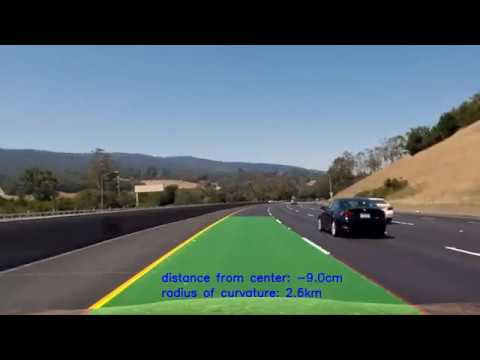

In [5]:
YouTubeVideo('NMCZenKgDoM')

In [ ]:
output_dir= './output_images/'
clip_input_file = 'harder_challenge_video.mp4'
clip_output_file = output_dir +'processed_' + clip_input_file
clip = VideoFileClip(clip_input_file)
clip_output = clip.fl_image(process_image)
%time clip_output.write_videofile(clip_output_file, audio=False)

# 4. Discussion

### 4.1 Problems/issues

This project is very challenging since I am new to computer vision. I think there are some difficulties I faced during this project:

- It's difficult to automatically detect the src and dst points for perspective transform as well as figure out the right size of sliding window to detect lane lines. Another problemis that how to effectively find the best combination of binary image and paired with its best threshold causes problematic.


- It's hard to get the pipeline to be robust against shadows and at the same time capable of detecting yellow lane lines on white ground. Maybe building separate lane line detectors for yellow and white together with additional logic which line to choose will work.


- The pipeline fails as soon as more (spurious) lines are on the same lane, as e.g. in the first challenge video.


- I hope I can learn how to apply deep learning for lane lines detection. 